# Fitting late learning with an early learning shape with only a scale factor


In [3]:
%load_ext autoreload
%autoreload 2
import cascade as cas
import flow
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
import pandas as pd
import warnings
from cascade import utils
from scipy.stats import pearsonr
from copy import deepcopy

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
# set parameters
mice = cas.lookups.mice['all12']
# words = ['facilitate'] * len(mice)
words = ['bookmarks' if s in 'OA27' else 'horrible' for s in mice]
group_by = 'all3'

rank_level_sort = 15

# load in a full size tensor
model_list = []
tensor_list = []
id_list = []
bhv_list = []
meta_list = []
for mouse, word in zip(mice, words):
    
    # return   model, ids, tensor, meta, bhv
    out = cas.load.load_all_groupday(mouse, word=word, with_model=True, group_by=group_by, nan_thresh=0.95)
    sorted_model, sort_order = utils.sortfactors(out[0])
    model_list.append(sorted_model)
    tensor_list.append(out[2][sort_order[rank_level_sort - 1], :, :])
    id_list.append(out[1][sort_order[rank_level_sort - 1]])
    bhv_list.append(out[4])
    meta_list.append(utils.add_stages_to_meta(out[3], 'parsed_11stage'))

Updated naive cs-ori pairings to match learning.
     135 plus
     270 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     0 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     135 plus
     0 minus
     270 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     135 plus
     0 minus
     270 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match le

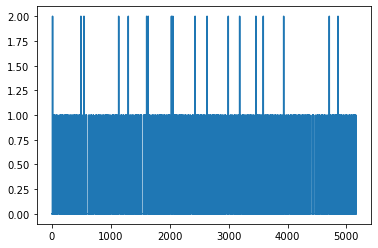

In [7]:
test = np.zeros(len(meta))
test[meta.prev_blank] = 1
test[(test == 1) & (np.diff(test, prepend=0) == 0)] = 2
plt.plot(test)

309 285 763 2710 8746


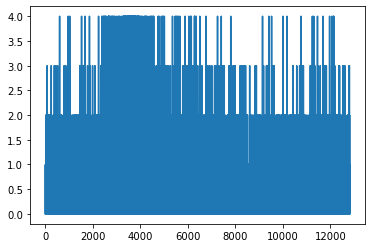

In [288]:
prev_same = (meta.prev_same_plus | meta.prev_same_minus | meta.prev_same_neutral).values
same_in_a_row = np.zeros(len(meta))
same_in_a_row[prev_same] = 1
possible_double = np.diff(same_in_a_row, prepend=0) == 0
possible_triple = np.diff(np.diff(same_in_a_row, prepend=0), prepend=0) == 0
possible_quad = np.diff(np.diff(np.diff(same_in_a_row, prepend=0), prepend=0), prepend=0) == 0
same_in_a_row[prev_same & possible_double] = 2
same_in_a_row[prev_same & possible_double & possible_triple] = 3
same_in_a_row[prev_same & possible_double & possible_triple & possible_quad] = 4
plt.plot(same_in_a_row)
print(np.sum(same_in_a_row == 4),np.sum(same_in_a_row == 3), np.sum(same_in_a_row == 2),
      np.sum(same_in_a_row == 1), np.sum(same_in_a_row == 0))

## get tuning of cells a few different ways

In [3]:
tuning_list = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    df = cas.tuning.cell_tuning(meta, tensor, model, 15, by_stage=True, staging='parsed_11stage', tuning_type='cond')
    tuning_list.append(df)

tuning_list_init = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    df = cas.tuning.cell_tuning(meta, tensor, model, 15, by_stage=True, staging='parsed_11stage', tuning_type='initial')
    tuning_list_init.append(df)
    
tuning_list_ori = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    df = cas.tuning.cell_tuning(meta, tensor, model, 15, by_stage=True, staging='parsed_11stage', tuning_type='orientation')
    tuning_list_ori.append(df)

s:\twophoton_analysis\code\cascade\cascade\utils.py:1506: RuntimeWarning: All-NaN slice encountered
  above_thresh = ~np.isnan(np.nanmax(weights, axis=1))
s:\twophoton_analysis\code\cascade\cascade\tuning.py:72: RuntimeWarning: Mean of empty slice
  trial_avg_vec = np.nanmean(cell_mat, axis=0)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:350: RuntimeWarning: Mean of empty slice
  mean_cue.append(np.nanmean(rect_trial_avg_vec[cue_boo]))
s:\twophoton_analysis\code\cascade\cascade\tuning.py:402: RuntimeWarning: Mean of empty slice
  mean_cue.append(np.nanmean(rect_trial_avg_vec[cue_boo]))


In [5]:
tuning_list_LR = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    df = cas.tuning.cell_tuning(meta, tensor, model, 15, by_stage=False, by_reversal=True, staging='parsed_11stage', tuning_type='cond')
    tuning_list_LR.append(df)
    
tuning_list_LR_init = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    df = cas.tuning.cell_tuning(meta, tensor, model, 15, by_stage=False, by_reversal=True, staging='parsed_11stage', tuning_type='initial')
    tuning_list_LR_init.append(df)

s:\twophoton_analysis\code\cascade\cascade\utils.py:1570: RuntimeWarning: All-NaN slice encountered
  above_thresh = ~np.isnan(np.nanmax(weights, axis=1))
s:\twophoton_analysis\code\cascade\cascade\tuning.py:80: RuntimeWarning: Mean of empty slice
  trial_avg_vec = np.nanmean(cell_mat, axis=0)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:358: RuntimeWarning: Mean of empty slice
  mean_cue.append(np.nanmean(rect_trial_avg_vec[cue_boo]))
s:\twophoton_analysis\code\cascade\cascade\tuning.py:410: RuntimeWarning: Mean of empty slice
  mean_cue.append(np.nanmean(rect_trial_avg_vec[cue_boo]))


In [6]:
tuning_list_LR_init[0].head()

staging_LR preferred tuning  \
mouse cell_n                               
AS20  1        learning    minus-neutral   
      1       reversal1    minus-neutral   
      2        learning    minus-neutral   
      2       reversal1       minus-plus   
      3        learning            broad   

                                                  cosine tuning  \
mouse cell_n                                                      
AS20  1       [0.18814802662058072, 0.5078259115711341, 0.68...   
      1       [0.173283506774627, 0.5926256281618041, 0.6119...   
      2       [0.2617321530529646, 0.39484569149883253, 0.70...   
      2       [0.20967973190429112, 0.7669953124199677, 0.43...   
      3       [0.4933776456452097, 0.42811702143167507, 0.35...   

                                                  mean response  \
mouse cell_n                                                      
AS20  1       [0.19121867699986278, 0.035653829857502845, -0...   
      1       [0.9179728905670892, 0.4096208618044614, 0.321...   
      2       [0.010768001917793521, -0.03860907489727616, -...   
      2       [0.6412183672981818, -0.012146381395101321, 0....   
      3       [0.10714639451807724, 0.1488172515690374, 0.20...   

              best component  offset component  offset cell  \
mouse cell_n                                                  
AS20  1                  1.0               1.0         True   
      1                  1.0               1.0         True   
      2                  1.0               1.0         True   
      2                  1.0               1.0         True   
      3                  1.0               1.0         True   

              component participation  offset participation  
mouse cell_n                                                 
AS20  1                             1                  True  
      1                             1                  True  
      2                             2                  True  
      2                             2                  True  
      3                             1                  True

## get stage averages (cells averaged per stage of learning), their tuning, and a flattened matrix for preferred tuning across stages

s:\twophoton_analysis\code\cascade\cascade\tuning.py:460: RuntimeWarning: Mean of empty slice
  cue_stage_mean = np.nanmean(cue_stage_tensor, axis=2)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:487: RuntimeWarning: Mean of empty slice
  tuned_response = np.nanmean(mouse_stage_responses[cell_n, :, cs, tuning_levels], axis=0)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:482: RuntimeWarning: Mean of empty slice
  mean_resp = np.nanmean(mouse_stage_responses[cell_n, :, cs, :], axis=1)
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:49: RuntimeWarning: All-NaN slice encountered
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure

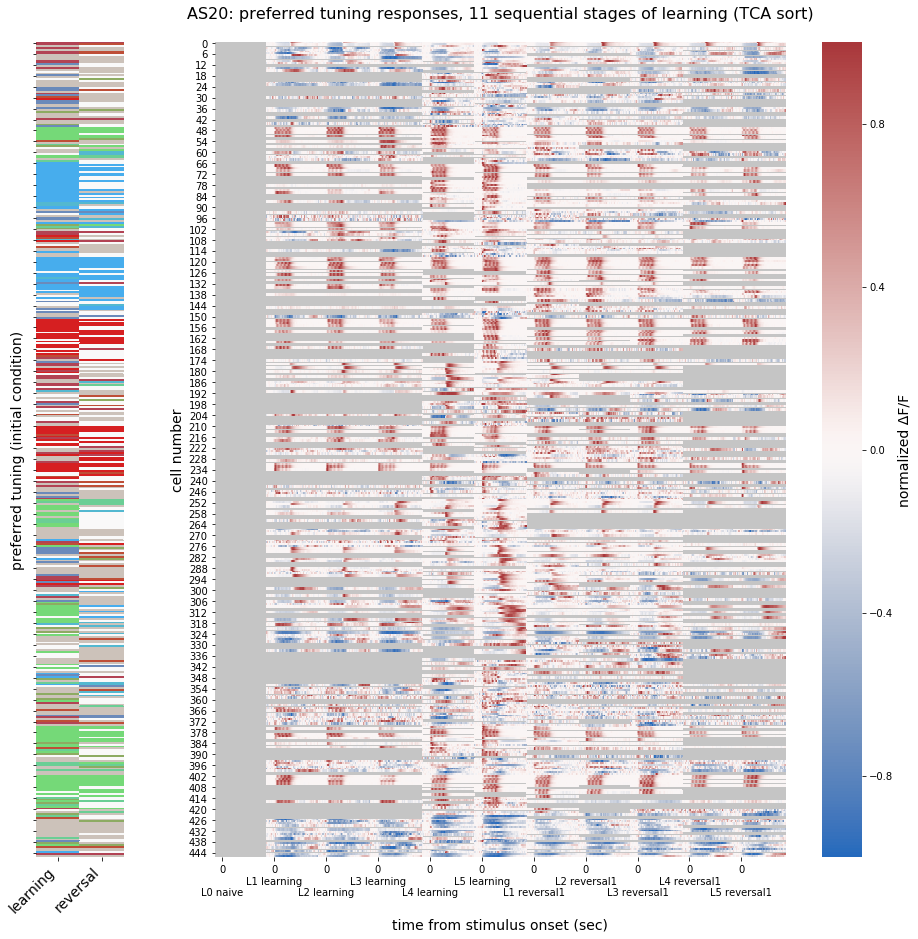

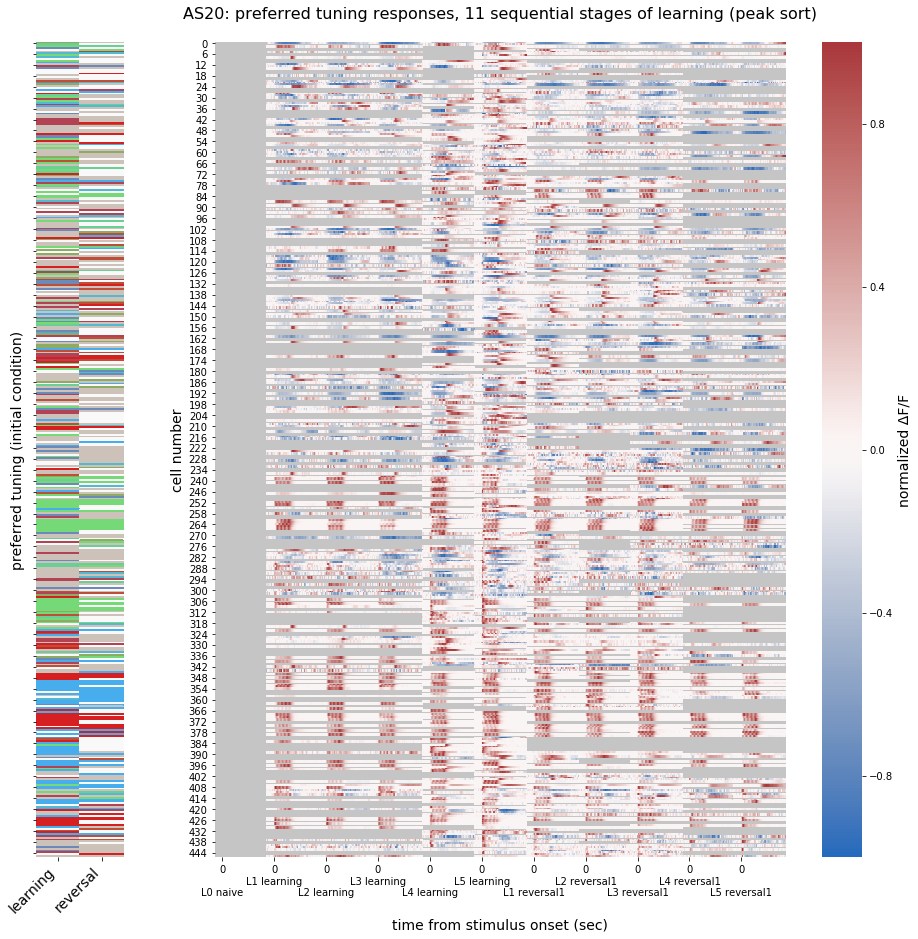

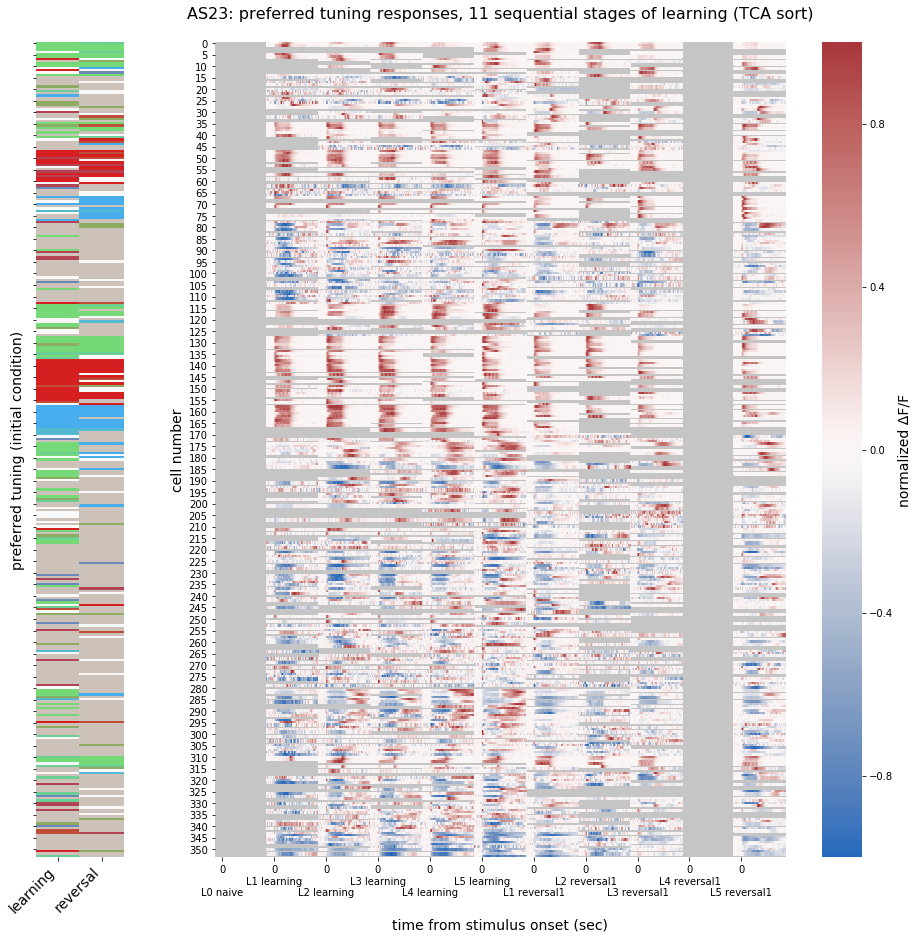

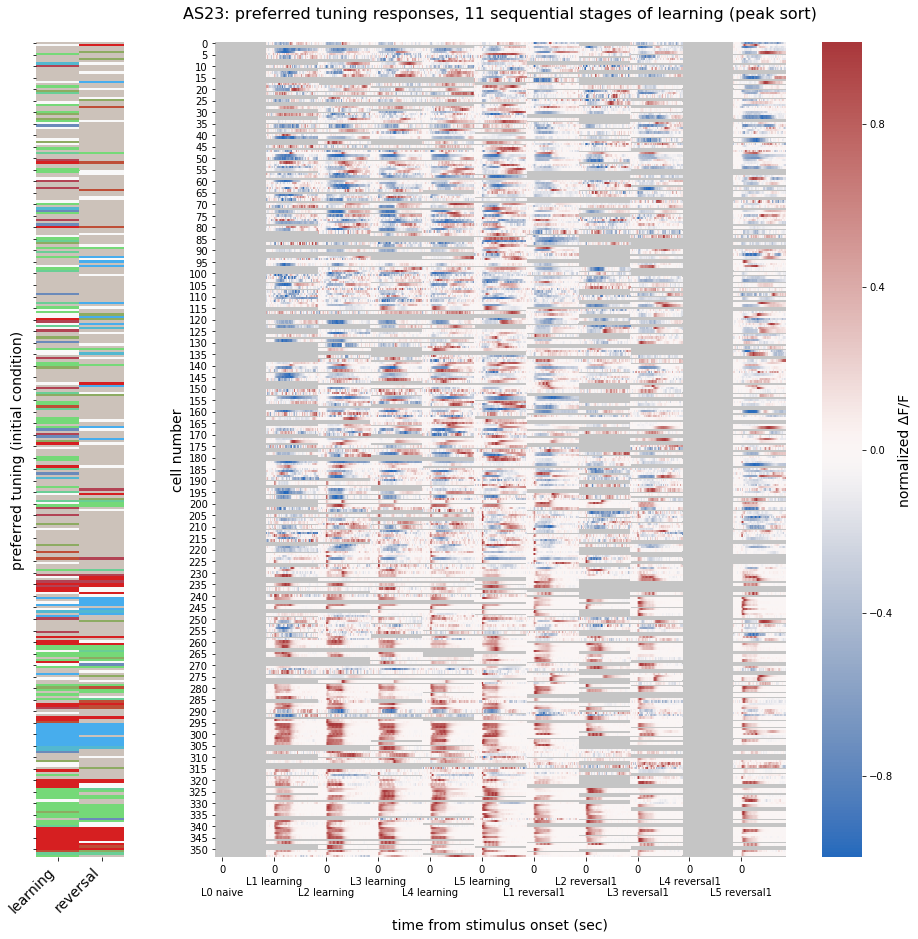

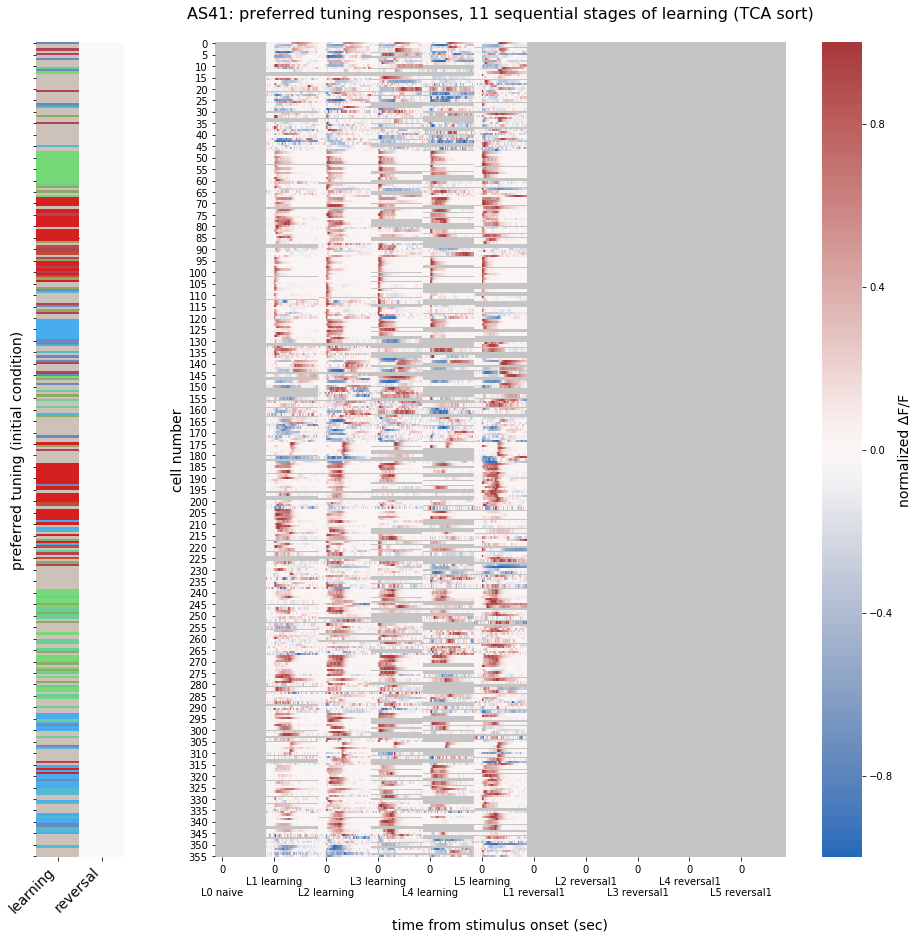

...

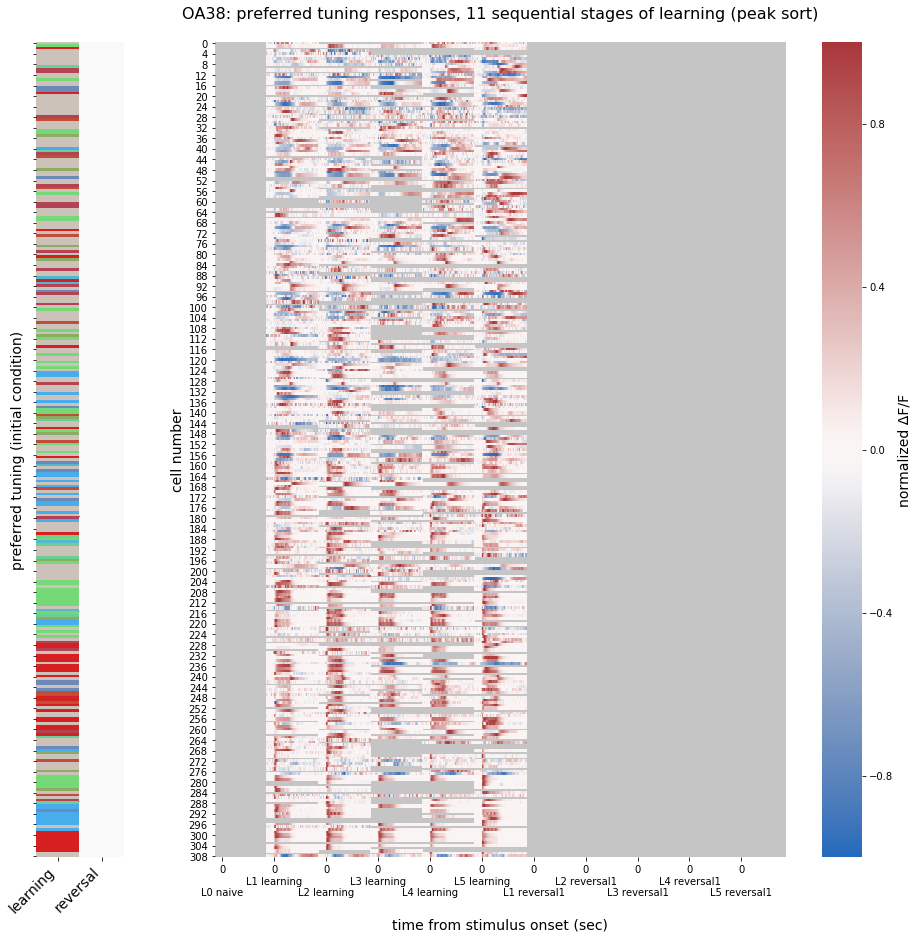

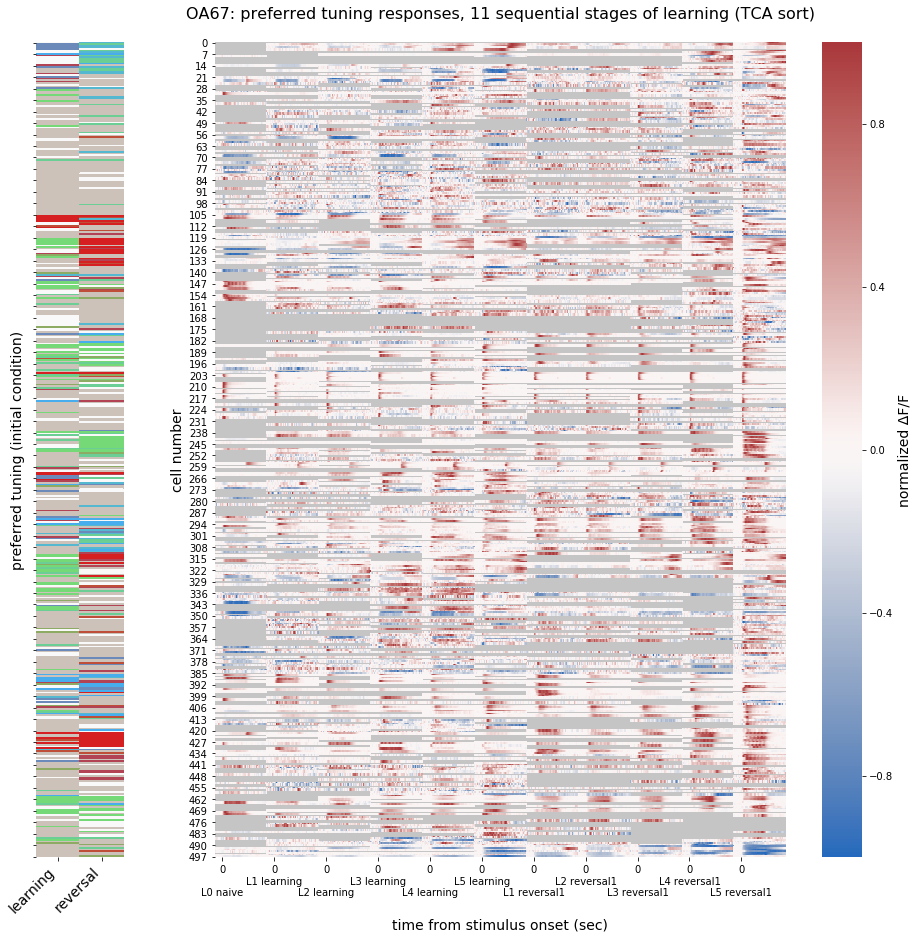

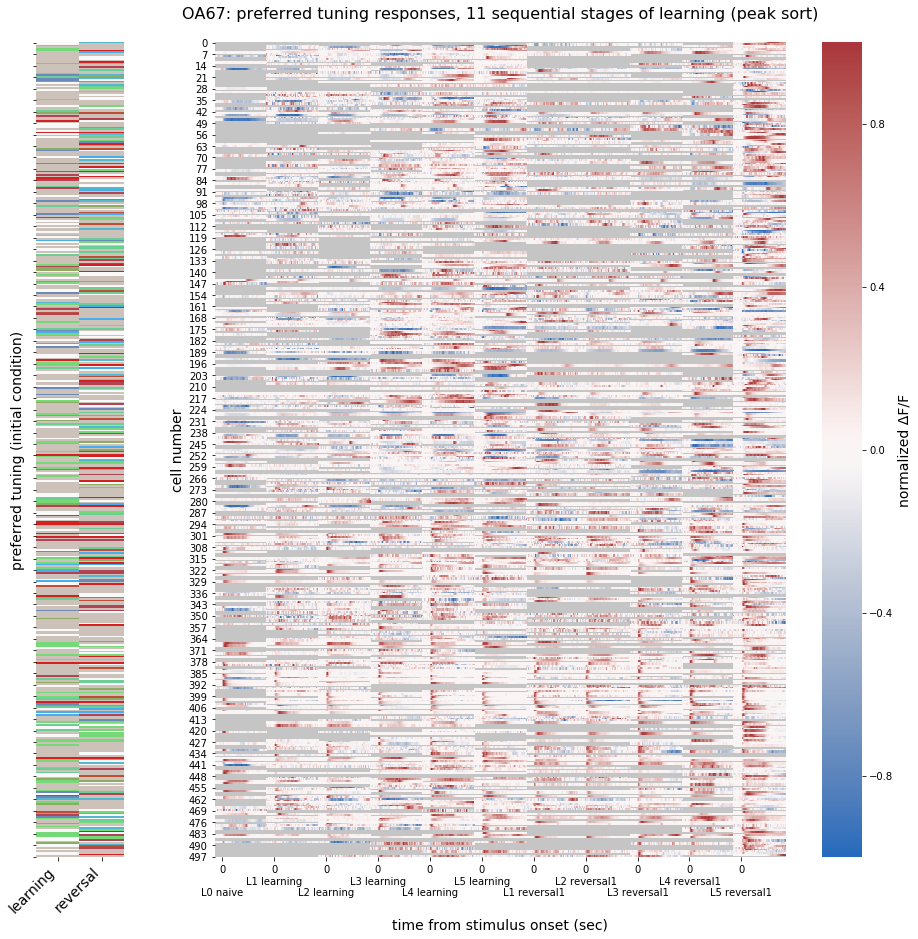

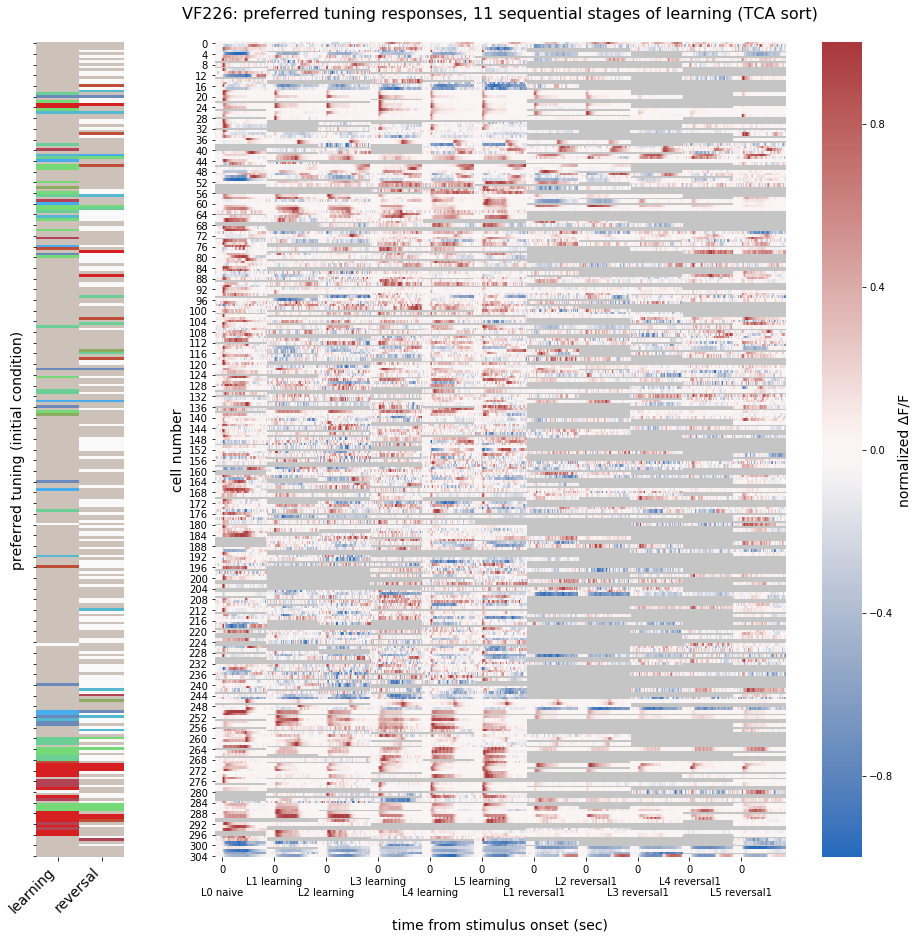

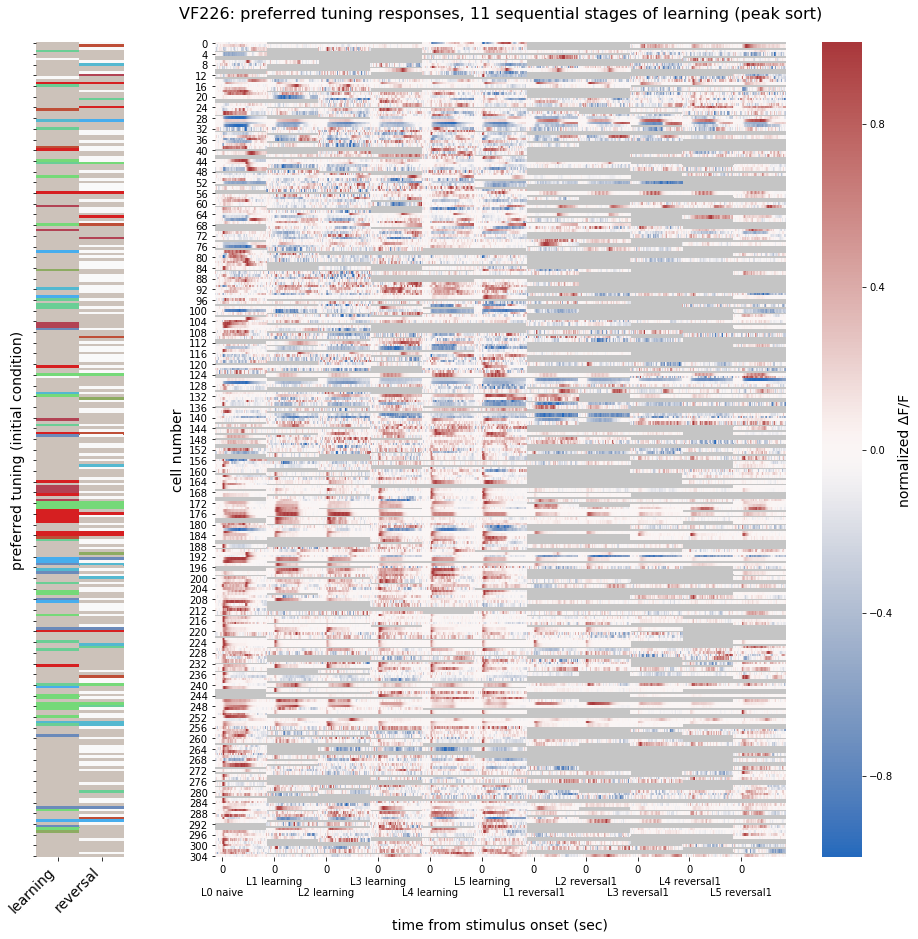

In [227]:

# allow for mapping between digits and colors (rather than tuning strings to colors)
possible_tuning = ['broad', 'minus', 'minus-neutral', 'minus-plus', 'neutral',
       'neutral-minus', 'neutral-plus', 'none', 'plus', 'plus-minus',
       'plus-neutral']
color_mapper = {} # map numbers to colors
list_mapper = {} # map colors to numbers
counter = 0
for k,v in cas.lookups.color_dict.items():
    if k not in possible_tuning:
        continue
    color_mapper[counter] = v
    list_mapper[k] = counter
    counter += 1

    
for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list_LR_init):
    mat4d, mat2d, stune, scos = cas.tuning.mean_stage_response_preferred_tuning_flat(meta, tensor, tune, staging='parsed_11stage',
                                                                    tune_staging='staging_LR', tuning_type='initial')
    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]
    
    # sort on peak for one plot output
    mean_all_time = np.nanmean(mat4d[:,:,:,3], axis=2)
    peak_sort = np.argsort(np.argmax(mean_all_time[:, :18], axis=1))

    # map colors
    tune_l1 = []
    for s1 in stune:
        tune_l2 = []
        for s2 in s1:
            tune_l2.append(list_mapper[s2])
        tune_l1.append(tune_l2)
    number_tune_mat = np.vstack(tune_l1)

    ax = []
    fig = plt.figure(figsize=(16, 15))
    gs = fig.add_gridspec(100, 100)
    ax.append(fig.add_subplot(gs[:, :10]))
    ax.append(fig.add_subplot(gs[:, 20:]))

    # plot "categorical" heatmap using defined color mappings
    sns.heatmap(number_tune_mat.T[:, :], cmap=list(color_mapper.values()), ax=ax[0], cbar=False)
    ax[0].set_xticklabels(['learning', 'reversal'], rotation=45, ha='right', size=14)
    ax[0].set_yticklabels([])
    ax[0].set_ylabel('preferred tuning (initial condition)', size=14)

    # optionally noramilze across row using maximum absolute value
    if norm_row:
        mat2d_norm = mat2d/np.nanmax(np.abs(mat2d), axis=1)[:, None]
        clabel = 'normalized \u0394F/F'
    else:
        mat2d_norm = mat2d
        clabel = '\u0394F/F (z-score)'

    g = sns.heatmap(mat2d_norm[:, :], ax=ax[1], center=0, cmap='vlag', cbar_kws={'label': clabel})
    g.set_facecolor('#c5c5c5')
    ax[1].set_title(f'{mouse}: preferred tuning responses, 11 sequential stages of learning (TCA sort)\n', size=16)
    stim_starts = [15.5 + 108*s for s in np.arange(len(cas.lookups.staging['parsed_11stage']))]
    stim_labels = [f'0\n\n{s}' if c%2 == 0 else f'0\n{s}' for c, s in enumerate(cas.lookups.staging['parsed_11stage'])]
    ax[1].set_xticks(stim_starts)
    ax[1].set_xticklabels(stim_labels, rotation=0)
    ax[1].set_ylabel('cell number', size=14)
    ax[1].set_xlabel('\ntime from stimulus onset (sec)', size=14)

    cbar = g.collections[0].colorbar
    cbar.set_label(clabel, size=14)

    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_heatmap_LR_tca_{mouse}.png', bbox_inches='tight')
    
    
    # PEAK SORTED PLOT  
    ax = []
    fig = plt.figure(figsize=(16, 15))
    gs = fig.add_gridspec(100, 100)
    ax.append(fig.add_subplot(gs[:, :10]))
    ax.append(fig.add_subplot(gs[:, 20:]))

    # plot "categorical" heatmap using defined color mappings
    sns.heatmap(number_tune_mat.T[peak_sort, :], cmap=list(color_mapper.values()), ax=ax[0], cbar=False)
    ax[0].set_xticklabels(['learning', 'reversal'], rotation=45, ha='right', size=14)
    ax[0].set_yticklabels([])
    ax[0].set_ylabel('preferred tuning (initial condition)', size=14)

    g = sns.heatmap(mat2d_norm[peak_sort, :], ax=ax[1], center=0, cmap='vlag', cbar_kws={'label': clabel})
    g.set_facecolor('#c5c5c5')
    ax[1].set_title(f'{mouse}: preferred tuning responses, 11 sequential stages of learning (peak sort)\n', size=16)
    stim_starts = [15.5 + 108*s for s in np.arange(len(cas.lookups.staging['parsed_11stage']))]
    stim_labels = [f'0\n\n{s}' if c%2 == 0 else f'0\n{s}' for c, s in enumerate(cas.lookups.staging['parsed_11stage'])]
    ax[1].set_xticks(stim_starts)
    ax[1].set_xticklabels(stim_labels, rotation=0)
    ax[1].set_ylabel('cell number', size=14)
    ax[1].set_xlabel('\ntime from stimulus onset (sec)', size=14)

    cbar = g.collections[0].colorbar
    cbar.set_label(clabel, size=14)

    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_heatmap_LR_peak_{mouse}.png', bbox_inches='tight')

    
    

## Get flattened heatmap with tuning dropping cells that are pre-post broad

s:\twophoton_analysis\code\cascade\cascade\tuning.py:471: RuntimeWarning: Mean of empty slice
  
D:\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:500: RuntimeWarning: Mean of empty slice
  stage_list = []
s:\twophoton_analysis\code\cascade\cascade\tuning.py:495: RuntimeWarning: Mean of empty slice
  tuning_levels = np.where([s in preferred_tuning for s in ['plus', 'minus', 'neutral']])[0]
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


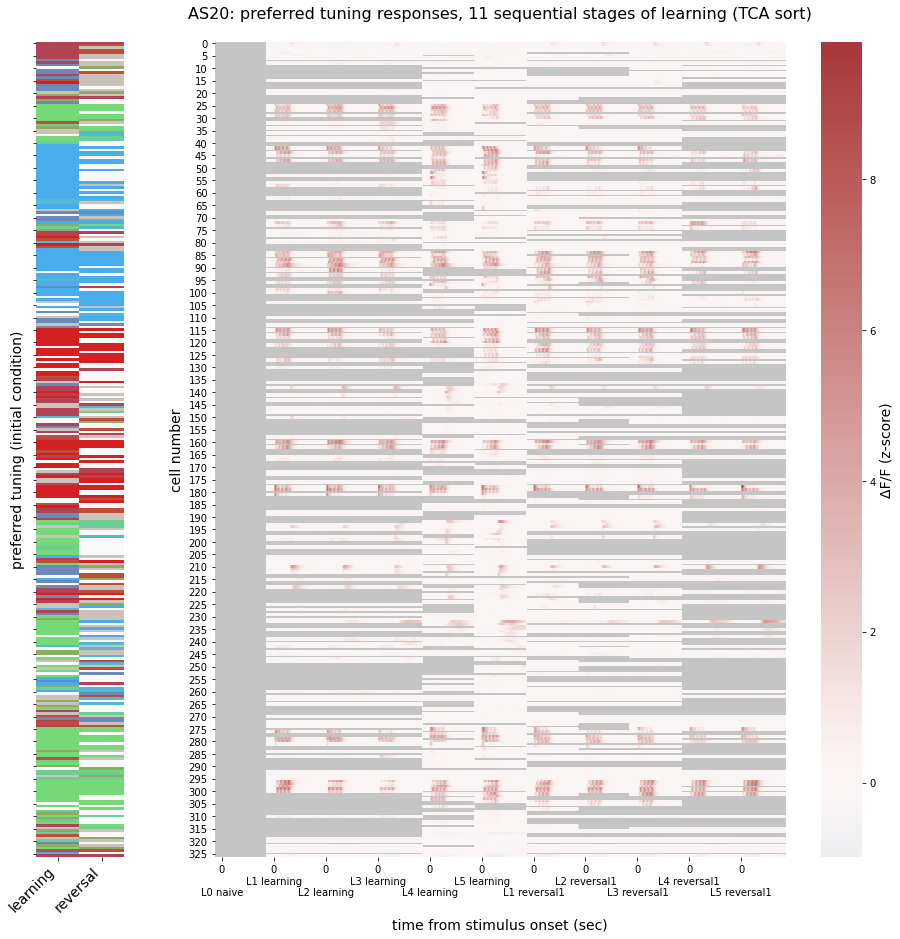

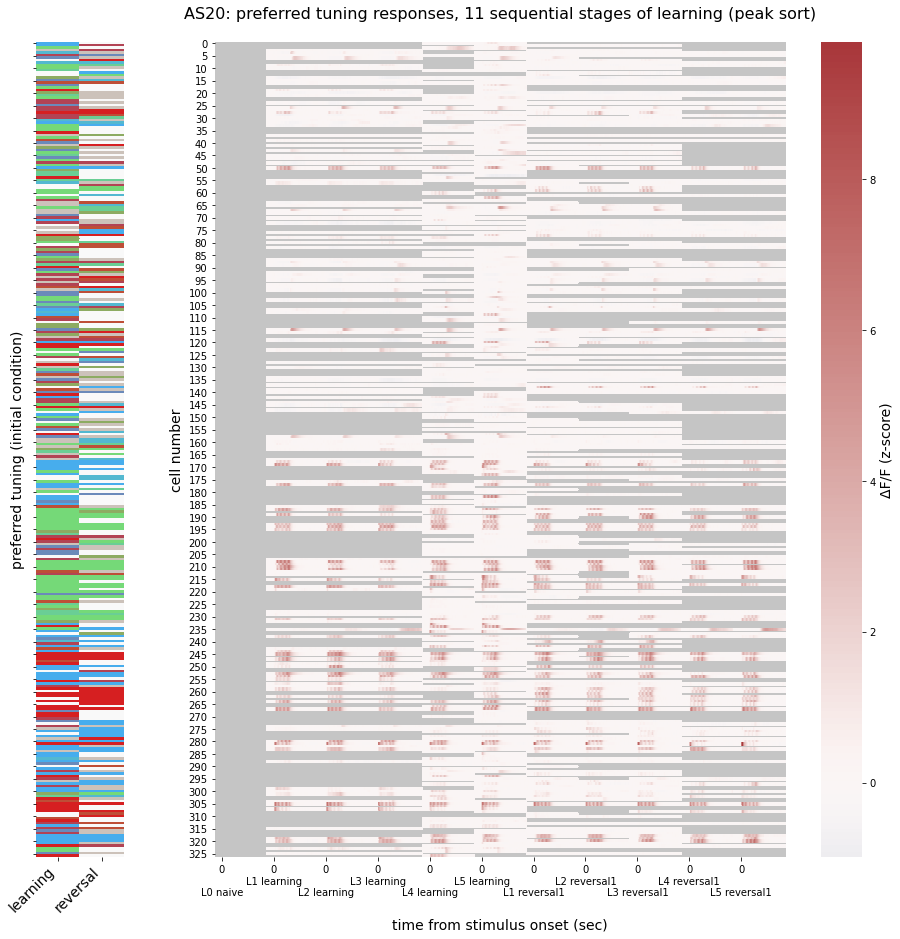

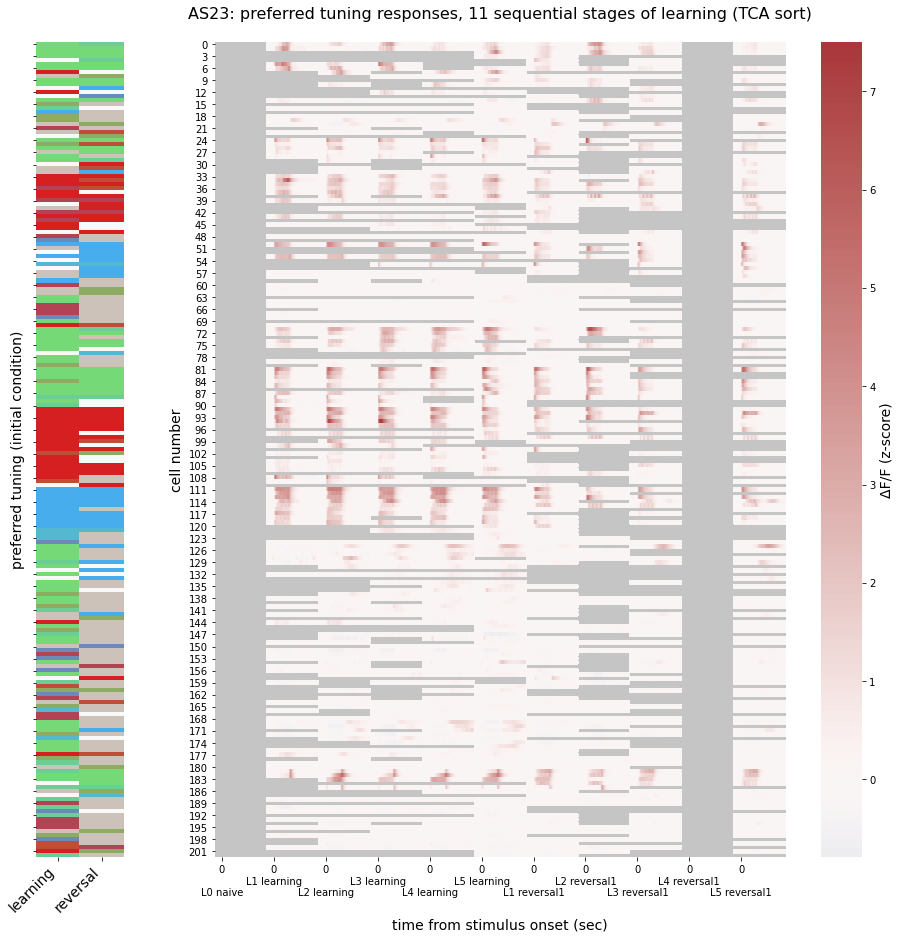

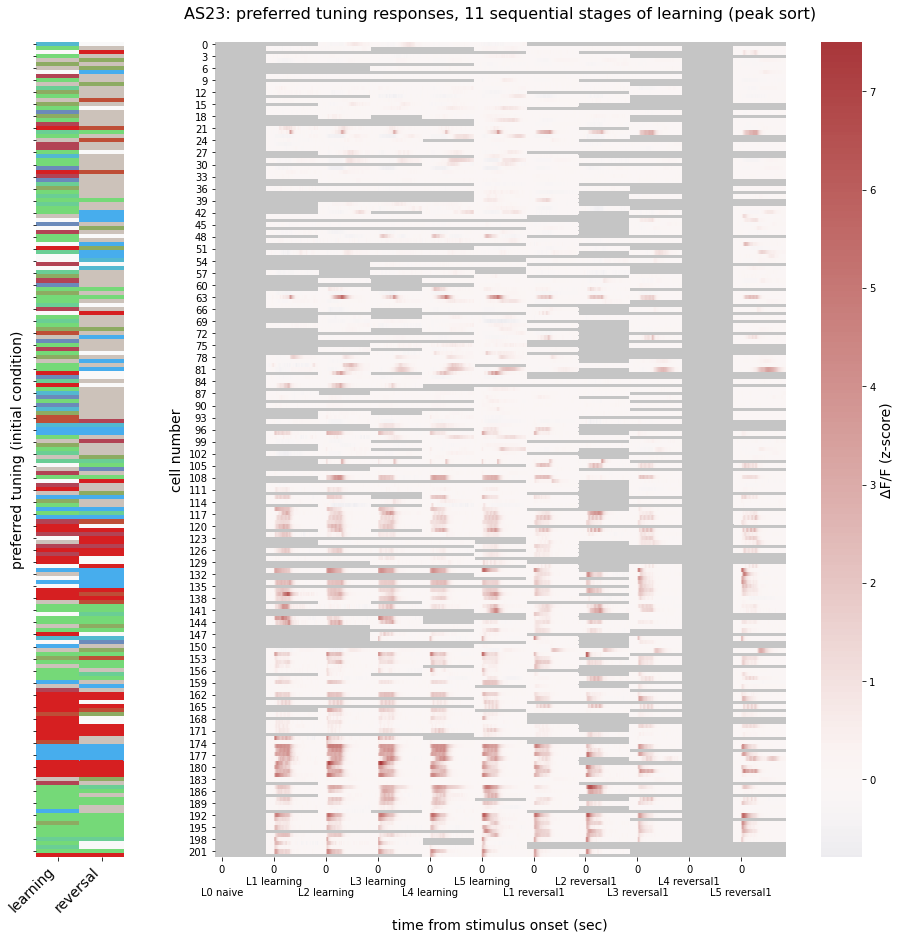

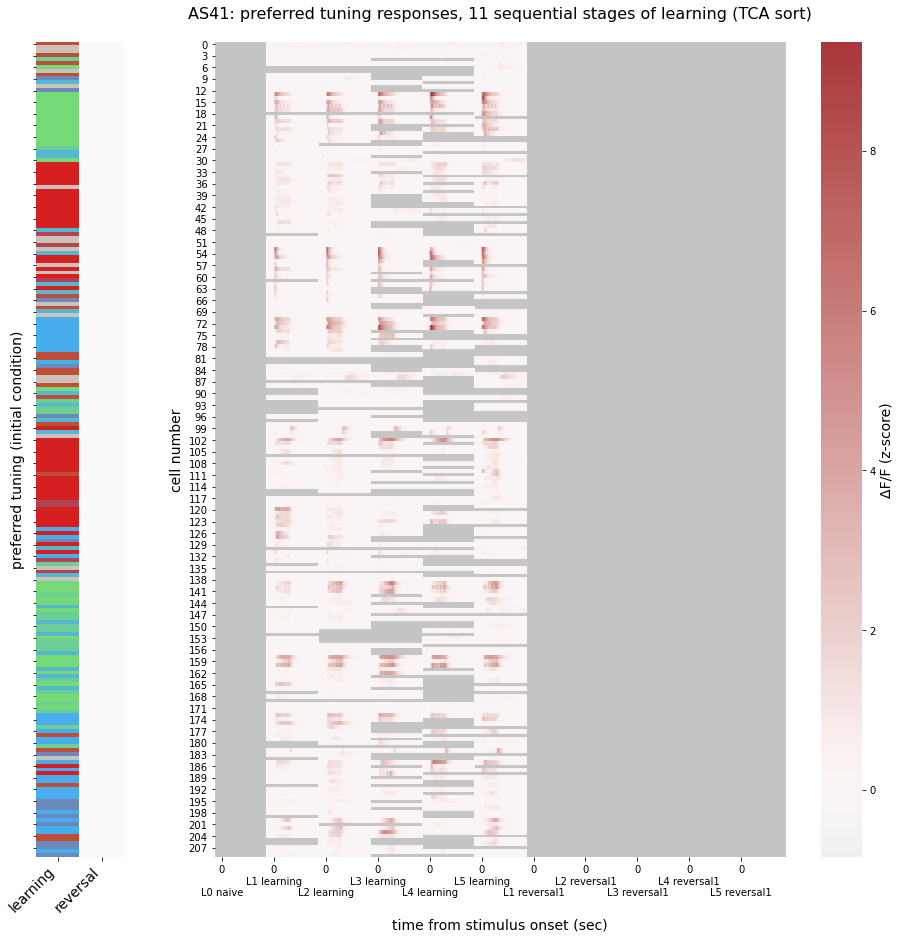

...

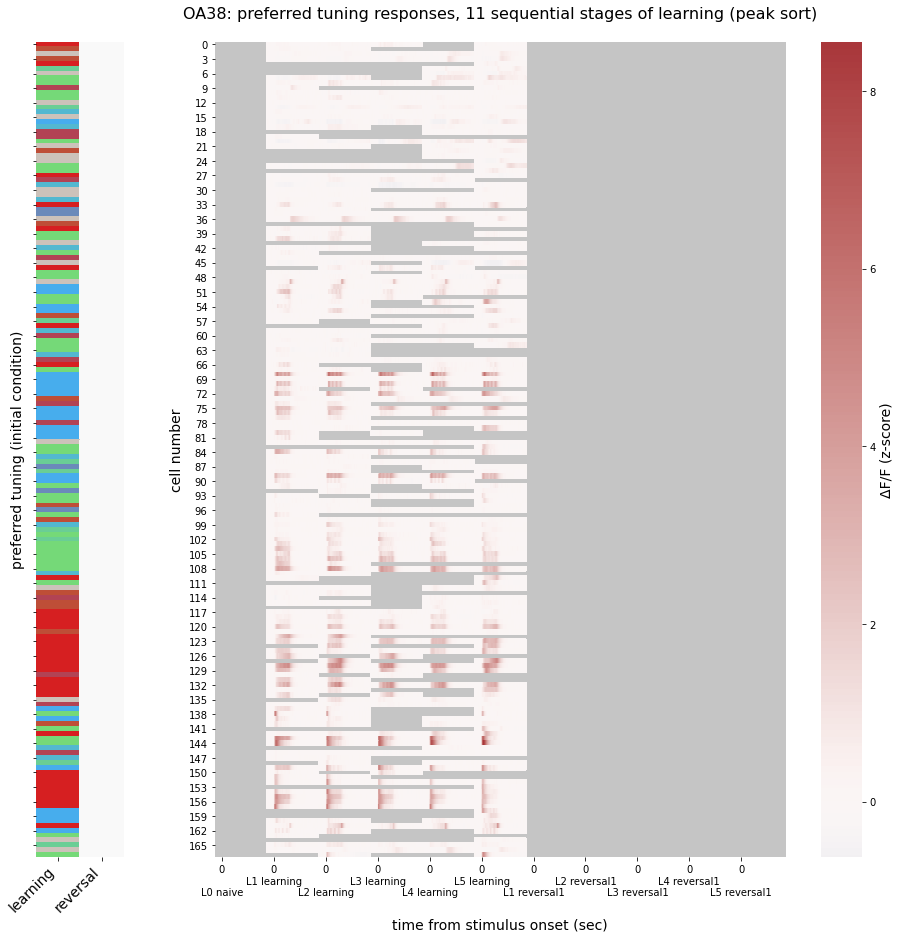

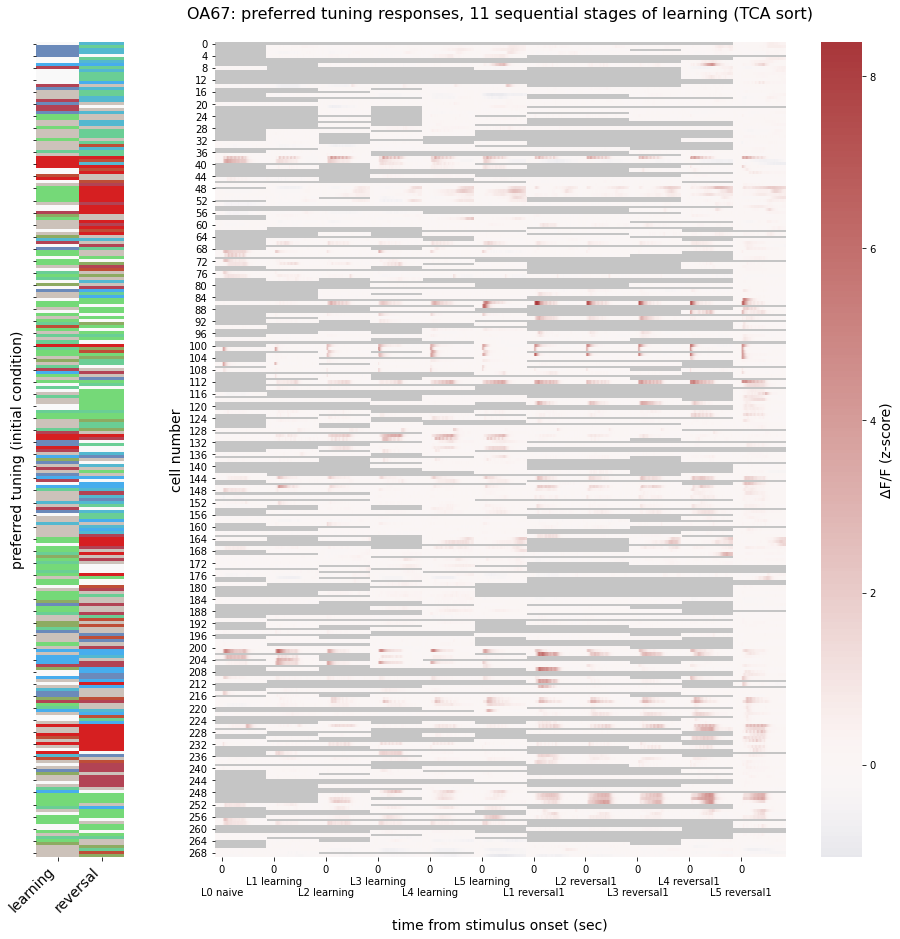

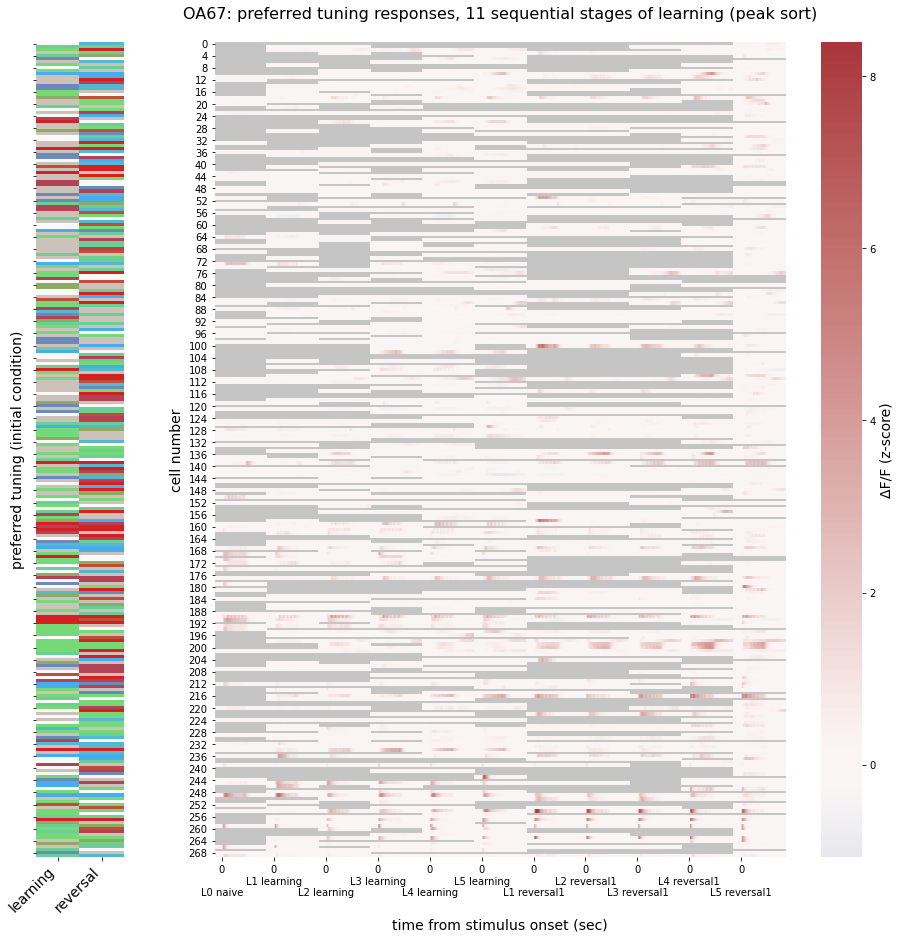

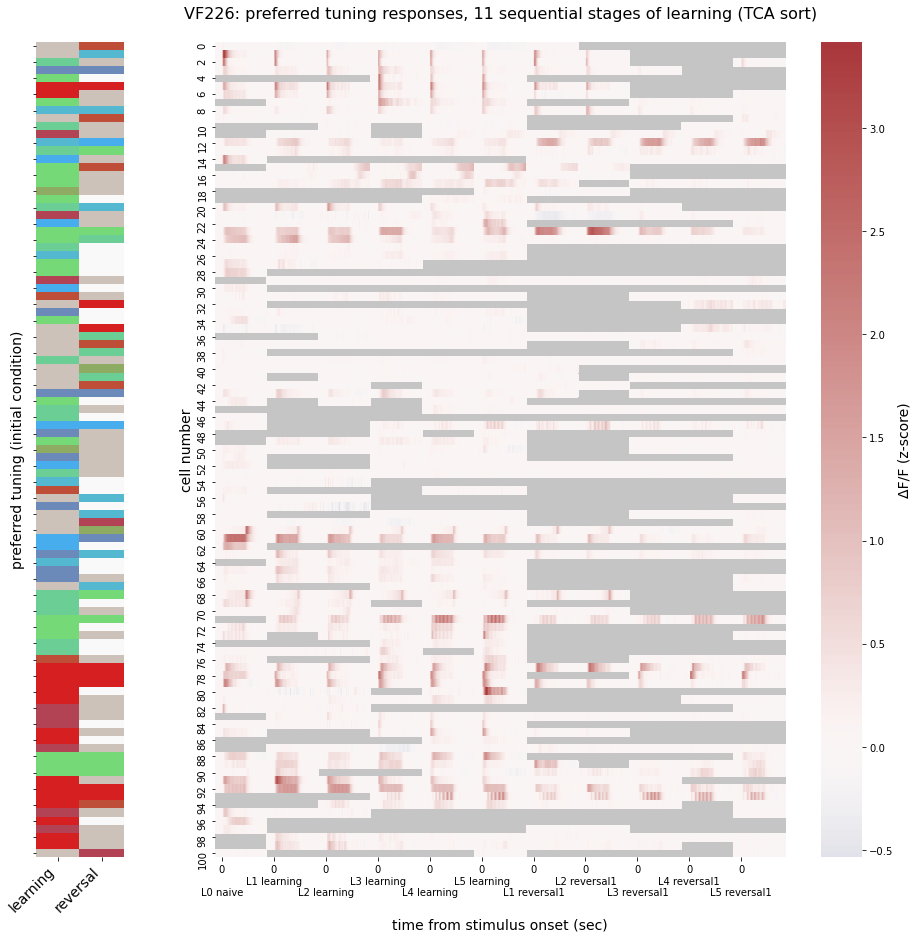

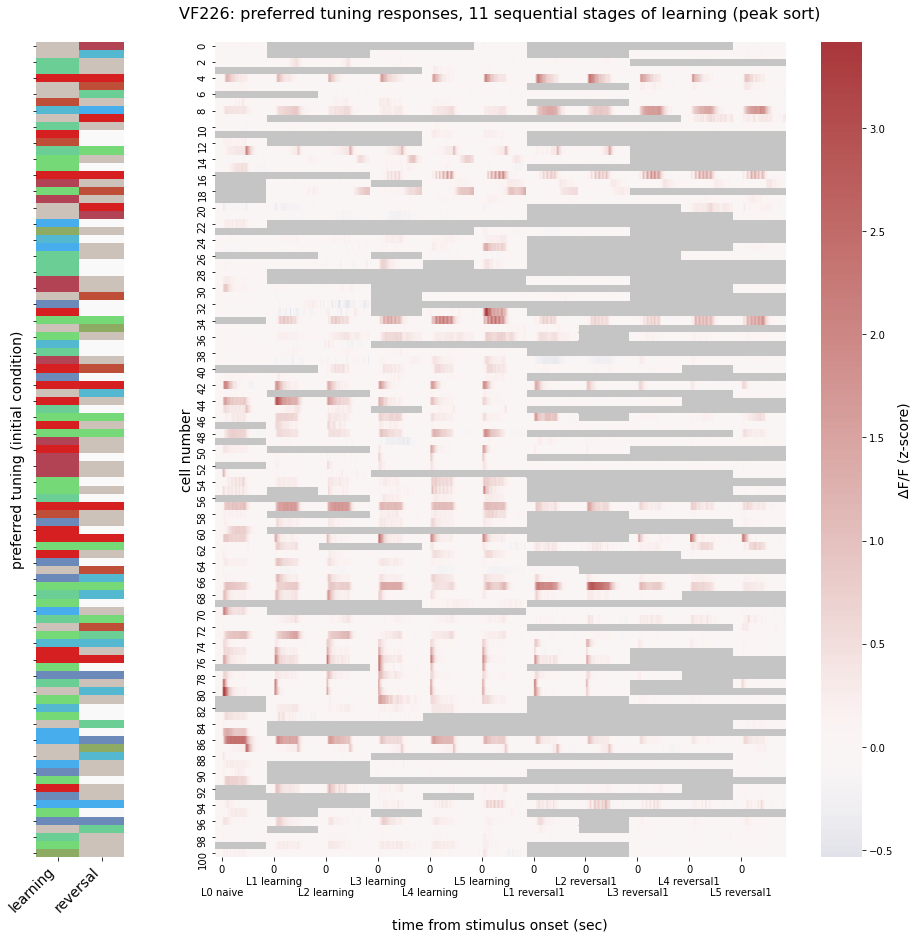

In [19]:
norm_row = False

# allow for mapping between digits and colors (rather than tuning strings to colors)
possible_tuning = ['broad', 'minus', 'minus-neutral', 'minus-plus', 'neutral',
       'neutral-minus', 'neutral-plus', 'none', 'plus', 'plus-minus',
       'plus-neutral']
color_mapper = {} # map numbers to colors
list_mapper = {} # map colors to numbers
counter = 0
for k,v in cas.lookups.color_dict.items():
    if k not in possible_tuning:
        continue
    color_mapper[counter] = v
    list_mapper[k] = counter
    counter += 1

    
for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list_LR_init):
    mat4d, mat2d, stune, scos = cas.tuning.mean_stage_response_preferred_tuning(meta, tensor, tune, staging='parsed_11stage',
                                                                    tune_staging='staging_LR', tuning_type='initial')
    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]

    # map colors
    tune_l1 = []
    for s1 in stune:
        tune_l2 = []
        for s2 in s1:
            tune_l2.append(list_mapper[s2])
        tune_l1.append(tune_l2)
    number_tune_mat = np.vstack(tune_l1)
    
#     break
    # FIND CELLS that are broad pre and post
    broad_num = list_mapper['broad']
    none_num = list_mapper['none']
    d_broad = (number_tune_mat[0, :] == broad_num) & (number_tune_mat[1, :] == broad_num)
    d_none = (number_tune_mat[0, :] == none_num) & (number_tune_mat[1, :] == none_num)
    d_broadnone = (number_tune_mat[0, :] == broad_num) & (number_tune_mat[1, :] == none_num)
    d_nonebroad = (number_tune_mat[0, :] == none_num) & (number_tune_mat[1, :] == broad_num)
    double_broad = d_broad | d_broadnone | d_nonebroad | d_none
    
    # sort on peak for one plot output
    mean_all_time = np.nanmean(mat4d[~double_broad,:,:,3], axis=2)
    peak_sort = np.argsort(np.argmax(mean_all_time[:, :18], axis=1))

    ax = []
    fig = plt.figure(figsize=(16, 15))
    gs = fig.add_gridspec(100, 100)
    ax.append(fig.add_subplot(gs[:, :10]))
    ax.append(fig.add_subplot(gs[:, 20:]))

    # plot "categorical" heatmap using defined color mappings
    sns.heatmap(number_tune_mat.T[~double_broad, :], cmap=list(color_mapper.values()), ax=ax[0], cbar=False)
    ax[0].set_xticklabels(['learning', 'reversal'], rotation=45, ha='right', size=14)
    ax[0].set_yticklabels([])
    ax[0].set_ylabel('preferred tuning (initial condition)', size=14)

    # optionally noramilze across row using maximum absolute value
    if norm_row:
        mat2d_norm = mat2d/np.nanmax(np.abs(mat2d), axis=1)[:, None]
        clabel = 'normalized \u0394F/F'
        stag = ''
    else:
        mat2d_norm = mat2d
        clabel = '\u0394F/F (z-score)'
        stag = '_Z'

    g = sns.heatmap(mat2d_norm[~double_broad, :], ax=ax[1], center=0, cmap='vlag', cbar_kws={'label': clabel})
    g.set_facecolor('#c5c5c5')
    ax[1].set_title(f'{mouse}: preferred tuning responses, 11 sequential stages of learning (TCA sort)\n', size=16)
    stim_starts = [15.5 + 108*s for s in np.arange(len(cas.lookups.staging['parsed_11stage']))]
    stim_labels = [f'0\n\n{s}' if c%2 == 0 else f'0\n{s}' for c, s in enumerate(cas.lookups.staging['parsed_11stage'])]
    ax[1].set_xticks(stim_starts)
    ax[1].set_xticklabels(stim_labels, rotation=0)
    ax[1].set_ylabel('cell number', size=14)
    ax[1].set_xlabel('\ntime from stimulus onset (sec)', size=14)

    cbar = g.collections[0].colorbar
    cbar.set_label(clabel, size=14)
#     break
    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_NOdblbroad{stag}_heatmap_LR_tca_{mouse}.png', bbox_inches='tight')
    
    
    # PEAK SORTED PLOT  
    ax = []
    fig = plt.figure(figsize=(16, 15))
    gs = fig.add_gridspec(100, 100)
    ax.append(fig.add_subplot(gs[:, :10]))
    ax.append(fig.add_subplot(gs[:, 20:]))

    # plot "categorical" heatmap using defined color mappings
    sns.heatmap(number_tune_mat.T[~double_broad, :][peak_sort, :], cmap=list(color_mapper.values()), ax=ax[0], cbar=False)
    ax[0].set_xticklabels(['learning', 'reversal'], rotation=45, ha='right', size=14)
    ax[0].set_yticklabels([])
    ax[0].set_ylabel('preferred tuning (initial condition)', size=14)

    g = sns.heatmap(mat2d_norm[~double_broad, :][peak_sort, :], ax=ax[1], center=0, cmap='vlag', cbar_kws={'label': clabel})
    g.set_facecolor('#c5c5c5')
    ax[1].set_title(f'{mouse}: preferred tuning responses, 11 sequential stages of learning (peak sort)\n', size=16)
    stim_starts = [15.5 + 108*s for s in np.arange(len(cas.lookups.staging['parsed_11stage']))]
    stim_labels = [f'0\n\n{s}' if c%2 == 0 else f'0\n{s}' for c, s in enumerate(cas.lookups.staging['parsed_11stage'])]
    ax[1].set_xticks(stim_starts)
    ax[1].set_xticklabels(stim_labels, rotation=0)
    ax[1].set_ylabel('cell number', size=14)
    ax[1].set_xlabel('\ntime from stimulus onset (sec)', size=14)

    cbar = g.collections[0].colorbar
    cbar.set_label(clabel, size=14)

    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_NOdblbroad{stag}_heatmap_LR_peak_{mouse}.png', bbox_inches='tight')

    
    

array([0, 1])

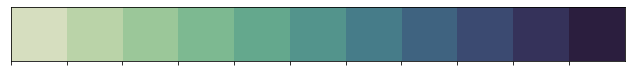

In [26]:
sns.palplot(sns.cubehelix_palette(11, start=.5, rot=-.75))

447

## get trace with sem plots for cells

In [62]:
norm_row = False

# allow for mapping between digits and colors (rather than tuning strings to colors)
possible_tuning = ['broad', 'minus', 'minus-neutral', 'minus-plus', 'neutral',
       'neutral-minus', 'neutral-plus', 'none', 'plus', 'plus-minus',
       'plus-neutral']
color_mapper = {} # map numbers to colors
list_mapper = {} # map colors to numbers
counter = 0
for k,v in cas.lookups.color_dict.items():
    if k not in possible_tuning:
        continue
    color_mapper[counter] = v
    list_mapper[k] = counter
    counter += 1

    
for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list_LR_init):
    mat4d, sem4d, mat2d, stune, scos = cas.tuning.mean_stage_response_preferred_tuning(meta, tensor, tune, staging='parsed_11stage',
                                                                    tune_staging='staging_LR', tuning_type='initial', return_sem=True)
    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]

    # map colors
    tune_l1 = []
    for s1 in stune:
        tune_l2 = []
        for s2 in s1:
            tune_l2.append(list_mapper[s2])
        tune_l1.append(tune_l2)
    number_tune_mat = np.vstack(tune_l1)
    
    # FIND CELLS that are broad pre and post
    broad_num = list_mapper['broad']
    none_num = list_mapper['none']
    d_broad = (number_tune_mat[0, :] == broad_num) & (number_tune_mat[1, :] == broad_num)
    d_none = (number_tune_mat[0, :] == none_num) & (number_tune_mat[1, :] == none_num)
    d_broadnone = (number_tune_mat[0, :] == broad_num) & (number_tune_mat[1, :] == none_num)
    d_nonebroad = (number_tune_mat[0, :] == none_num) & (number_tune_mat[1, :] == broad_num)
    double_broad = d_broad | d_broadnone | d_nonebroad | d_none
    
    # get cell mumber relative to tesnor index
#     cell_n_list = np.where(~double_broad)[0]
    

    cmap = sns.cubehelix_palette(11, start=.5, rot=-.75)
    
    # loop over and plot cells across stages
    for celli in range(tensor.shape[0]):    
        
        # skip cells with broad tuning or no tuning across learning-reversal
        if double_broad[celli]:
            continue
        
        # get cell pref response and sem across trials
        cell_stage_pref = mat4d[celli, :, :, 3].T
        cell_stage_sem = sem4d[celli, :, :, 3].T
        
        # skip missing cells
        if np.isnan(cell_stage_sem).all():
            continue
            
        cell_number = celli + 1
        
        fig, ax = plt.subplots(1, 1)
        for si in range(cell_stage_pref.shape[0]):
            color = cmap[si]
            cell_stage = cas.lookups.staging['parsed_11stage'][si]
            y_est = cell_stage_pref[si, :]
            ax.plot(np.arange(108), y_est, color=color, label=cell_stage)
            sem = cell_stage_sem[si, :]
            ax.fill_between(np.arange(108), y_est-sem, y_est+sem, alpha=0.5, color=color)
            
        sns.despine()
        plt.title(f'{mouse}: cell_n {cell_number}, cell_ind {np.where(np.where(~double_broad)[0] == cell_number-1)[0][0]} heatmap', size=14)
        plt.xticks(np.arange(15.5, 108, 15.5), labels=np.arange(0, 6, 1), size=12)
        plt.yticks(size=12)
        plt.xlabel('Time from stimulus onset', size=14)
        plt.ylabel('\u0394F/F (z-score)', size=14)
        plt.axvline(16, linestyle=':', color='red')
        plt.axvline((cas.lookups.stim_length[mouse]+1)*15.5, linestyle=':', color='red')
        plt.legend(loc=2, bbox_to_anchor=(0.85, 1))
        
        file_name = f'{mouse}_pref_tuning_LR_Ztrace_NOdblbroadnone_celln{cell_number}.png'
        base = '/twophoton_analysis/Data/analysis/Group-attractive/cell_traces_sem'
        if not os.path.isdir(base):
            os.mkdir(base)
        folderpath = os.path.join(base, f'{mouse}')
        if not os.path.isdir(folderpath):
            os.mkdir(folderpath)
        filepath = os.path.join(folderpath, file_name)
        plt.savefig(filepath, bbox_inches='tight')

    plt.close('all')  
 

s:\twophoton_analysis\code\cascade\cascade\tuning.py:471: RuntimeWarning: Mean of empty slice
  
D:\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:500: RuntimeWarning: Mean of empty slice
  stage_list = []
s:\twophoton_analysis\code\cascade\cascade\tuning.py:495: RuntimeWarning: Mean of empty slice
  tuning_levels = np.where([s in preferred_tuning for s in ['plus', 'minus', 'neutral']])[0]
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
s:\twophoton_analysis\code\cascade\cascade\tuning.py:471: RuntimeWarning: Mean of empty slice
  
D:\Anaconda3\lib\site-packages\numpy\lib\nanfu

In [ ]:
cell_number

In [61]:
np.where(np.where(~double_broad)[0] == cell_number-1)[0][0]

34

In [56]:
np.sum(~double_broad[:cell_number])
np.where(np.where(~double_broad)[0] == 296)[0][0]

array([99], dtype=int64)

In [55]:
np.where(~double_broad)[0]

array([ 16,  18,  19,  20,  22,  23,  24,  25,  26,  34,  38,  40,  42,
        43,  44,  46,  47,  52,  54,  56,  57,  59,  60,  61,  62,  63,
        65,  66,  70,  73,  76,  77,  78,  79,  80,  87,  95, 103, 105,
       106, 115, 116, 118, 122, 125, 130, 131, 134, 136, 138, 139, 164,
       167, 175, 192, 196, 212, 240, 242, 244, 246, 250, 251, 252, 253,
       254, 255, 257, 260, 261, 262, 264, 265, 266, 267, 268, 269, 270,
       271, 272, 273, 274, 276, 277, 278, 279, 282, 283, 285, 286, 287,
       288, 289, 290, 291, 292, 293, 294, 295, 296, 298], dtype=int64)

In [35]:
cell_stage_pref.shape[0]

11

## Look at OA27 for example cells

In [228]:
for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list_LR_init):
    
    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]
    
    if mouse in 'OA27':
        mat4d, mat2d, stune, scos = cas.tuning.mean_stage_response_preferred_tuning_flat(meta, tensor, tune, staging='parsed_11stage',
                                                                    tune_staging='staging_LR', tuning_type='initial')

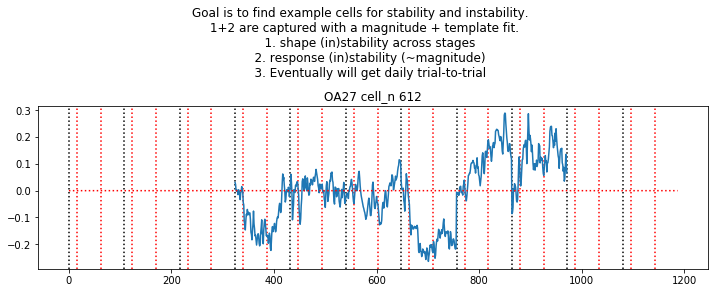

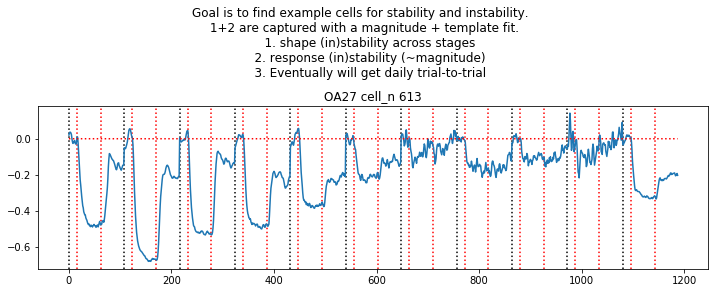

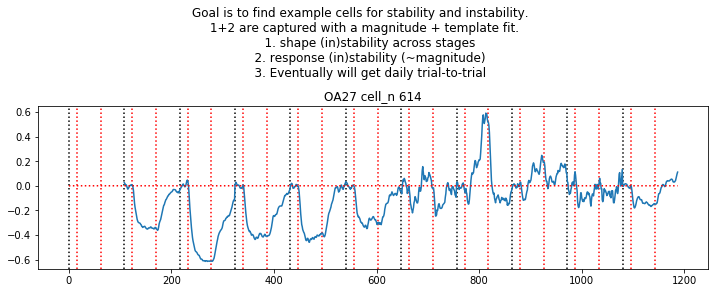

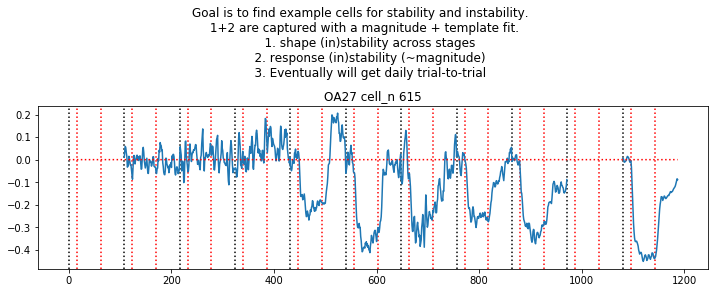

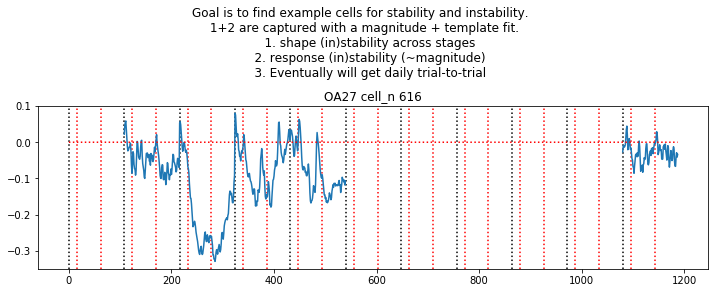

In [261]:
# plt.figure(figsize=(12, 3))
for i in np.arange(mat2d.shape[0]):
    plt.figure(figsize=(12, 3))
    plt.title(f'OA27 cell_n {i+1}')
    for k in np.arange(15.5, 108*11, 108):
        plt.axvline(k, color='red', linestyle=':')
        plt.axvline(k + 15.5*3, color='red', linestyle=':')
        plt.axvline(k - 15.5, color='black', linestyle=':')
#     plt.plot(mat2d[300:,:].T);
    plt.plot(np.arange(108*11), mat2d[i,:]);
    plt.plot(np.arange(108*11), np.zeros(108*11), color='red', linestyle=':')
    plt.suptitle('Goal is to find example cells for stability and instability. \n 1+2 are captured with a magnitude + template fit.' +
                '\n    1. shape (in)stability across stages\n    2. response (in)stability (~magnitude)\n' +
                '    3. Eventually will get daily trial-to-trial', position=(0.5, 1.0), va='bottom') 
    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/OA27_11stage_traces/pref_tuning_rownorm_mOA27_c{i+1}.png', bbox_inches='tight')
    
    if i % 10 == 0:
        plt.close('all')
#     if i > 10:
#         break

# Fano factor

## fano factor across stages

In [283]:
for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list_LR_init):
    
    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]
    
    if mouse in 'OA27':
        mat4d, mat2d, stune, scos = cas.tuning.mean_day_response_preferred_tuning(meta, tensor, tune, staging='parsed_11stage',
                                                                    tune_staging='staging_LR', tuning_type='initial')
        
        
#         mat4d[:,:,:]

s:\twophoton_analysis\code\cascade\cascade\tuning.py:593: RuntimeWarning: Mean of empty slice
s:\twophoton_analysis\code\cascade\cascade\tuning.py:624: RuntimeWarning: Mean of empty slice
s:\twophoton_analysis\code\cascade\cascade\tuning.py:619: RuntimeWarning: Mean of empty slice


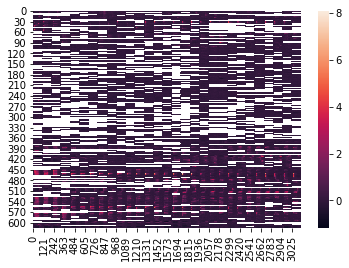

In [284]:
sns.heatmap(mat2d)

(0, 100)

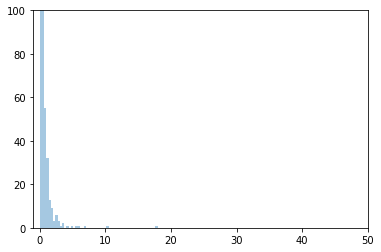

In [277]:
sfano = np.abs(np.nanvar(mat2d, axis=1)/np.nanmean(mat2d, axis=1))
# plt.plot(sorted(sfano))
# plt.ylim([-2.5, 2.5])
sns.distplot(sfano, kde=False, bins=1000)
plt.xlim([-1, 50])
plt.ylim([0, 100])

## fano factor across trials

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: Mean of empty slice
  


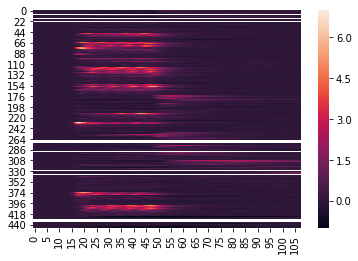

In [333]:
# debug
sns.heatmap(np.nanmean(pt, axis=2))

### getting a sense for fanofactor

Text(0.5, 1.0, 'fano factor')

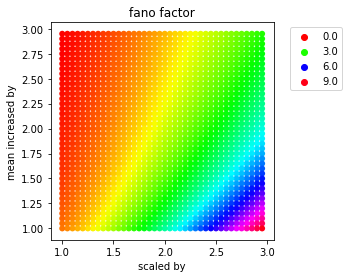

In [566]:
vec = np.random.randn(1000)

plt.figure(figsize=(4,4))
vec_x, vec_y, vec_c = [], [], []
for i in np.arange(1, 3, 0.05)[::-1]:
#     plt.figure(figsize=(10,4))
    for k in np.arange(1, 3, 0.05)[::-1]:
        fano = np.nanvar(vec*i + k)/np.nanmean(vec*i + k)
#         plt.plot(vec*k + 1, label=f'scaled by {i}, mean {k}: {round(fano, 2)}')
        vec_x.append(i)
        vec_y.append(k)
        vec_c.append(fano)
sns.scatterplot(vec_x, vec_y, hue=vec_c, palette='hsv', linewidth=0)
plt.legend(loc=2, bbox_to_anchor=(1.05, 1))
plt.xlabel('scaled by')
plt.ylabel('mean increased by')
plt.title('fano factor')

# Create preferred tensor list

In [7]:
pref_tensor_list = []
# pref_tensor_list_best = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    
    pt = cas.tuning.preferred_tensor(meta, tensor, model, tune_staging='staging_LR', best_tuning_only=True, drop_broad_tuning=True)
    pref_tensor_list.append(pt)         
#     pt2 = preferred_tensor(meta, tensor, model, tune_staging='staging_LR', best_tuning_only=True, drop_broad_tuning=True)
#     pref_tensor_list_best.append(pt2)


In [ ]:
# for meta, pref_tensor, tensor in zip(meta_list, pref_tensor_list, tensor_list):
    
#     mouse = meta.reset_index()['mouse'].unique()[0]
#     np.save(f'/twophoton_analysis/Data/analysis/Group-attractive/all12_pref_tensor_list_{mouse}.npy', pref_tensor)

In [75]:
loaded_pref_tensor_list = []
for meta in meta_list:
    
    mouse = meta.reset_index()['mouse'].unique()[0]
    pt = np.load(f'/twophoton_analysis/Data/analysis/Group-attractive/all12_pref_tensor_list_{mouse}.npy')
    loaded_pref_tensor_list.append(pt)

# Function calculations of stability:

## Calculate fano factor, peak latency, half-peak latancy, offset vec

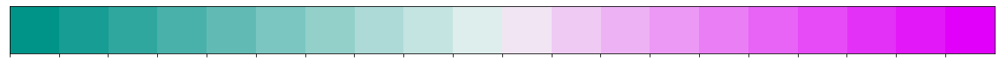

In [94]:
sns.palplot(sns.diverging_palette(180, 300, s=100, l=55, sep=1, n=20))

In [148]:
meta.columns

Index(['orientation', 'condition', 'initial_condition', 'trialerror',
       'prev_reward', 'prev_punish', 'prev_same_plus', 'prev_same_neutral',
       'prev_same_minus', 'prev_blank', 'hunger', 'learning_state', 'tag',
       'firstlick', 'firstlickbout', 'ensure', 'quinine', 'hmm_engaged',
       'speed', 'pre_speed', 'anticipatory_licks', 'pre_licks', 'pupil',
       'pre_pupil', 'brainmotion', 'go', 'reward', 'punishment',
       'p_initial_plus_since_last_initial_plus',
       'p_initial_minus_since_last_initial_plus',
       'p_initial_neutral_since_last_initial_plus',
       'p_go_since_last_initial_plus', 'p_reward_since_last_initial_plus',
       'p_initial_plus_since_last_initial_minus',
       'p_initial_minus_since_last_initial_minus',
       'p_initial_neutral_since_last_initial_minus',
       'p_go_since_last_initial_minus', 'p_reward_since_last_initial_minus',
       'p_initial_plus_since_last_initial_neutral',
       'p_initial_minus_since_last_initial_neutral',
      

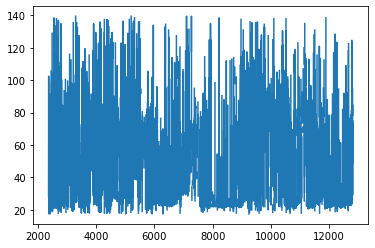

In [155]:
plt.plot(meta['firstlickbout'].values)

In [ ]:
stable_df_list = []
for meta, pref_tensor, tensor in zip(meta_list, loaded_pref_tensor_list, tensor_list):
    
    mouse = meta.reset_index()['mouse'].unique()[0]
#     if meta.reset_index()['mouse'].unique()[0] not in ['OA27']:
#         continue
        
    peak, half_peak = cas.stability.latency_to_half_peak(meta, pref_tensor, epoch='parsed_11stage')
    fano_tr = cas.stability.fano_factor_trials(meta, pref_tensor, epoch='parsed_11stage')
    fano_d = cas.stability.fano_factor_mean_days(meta, pref_tensor)
    corr_all = cas.stability.correlate_epochs_wall_mean(meta, pref_tensor, epoch='parsed_11stage')
    run_corr = cas.stability.correlate_wrunning_per_trial(meta, pref_tensor, epoch='parsed_11stage')
#     corr_early = cas.stability.correlate_epochs_wearly(meta, pref_tensor, epoch='parsed_11stage')
#     corr_L5 = cas.stability.correlate_epochs_wlate(meta, pref_tensor, epoch='parsed_11stage')
    corr_pop = cas.stability.correlate_epochs_wall_control(meta, pref_tensor, epoch='parsed_11stage')
    s_index = cas.stability.sustainedness95(meta, pref_tensor, epoch='parsed_11stage', full_trial_window=False)
    sensory_history = cas.stability.trial_history_sensory(meta, pref_tensor, epoch='parsed_11stage')
#     reward_history = cas.stability.trial_history_reward(meta, pref_tensor, epoch='parsed_11stage')
    punish_history = cas.stability.trial_history_punishment(meta, pref_tensor, epoch='parsed_11stage')
#     blank_history = cas.stability.trial_history_sensory_blank(meta, pref_tensor, epoch='parsed_11stage')
#     sensory_history_slow = cas.stability.trial_history_sensory(meta, pref_tensor, epoch='parsed_11stage', filter_running='low_speed_only')
#     sensory_history_fast = cas.stability.trial_history_sensory(meta, pref_tensor, epoch='parsed_11stage', filter_running='high_speed_only')
#     sine_fits = cas.stability.sine_fit_stage_response(meta, pref_tensor, epoch='parsed_11stage', plot_please=True)
    licks = cas.stability.lick_modulation(meta, pref_tensor, epoch='parsed_11stage')
    lickcorr = cas.stability.correlate_wlicking_per_trial(meta, pref_tensor, epoch='parsed_11stage')
    lickonscorr = cas.stability.correlate_wlickingonset_per_trial(meta, pref_tensor, epoch='parsed_11stage')
    running = cas.stability.run_modulation(meta, pref_tensor, epoch='parsed_11stage')
    offvec = cas.utils.get_offset_cells(meta, tensor)
    
    # parse f1/f0
#     f1f0 = sine_fits[:,:,0]/sine_fits[:,:,-1] # sine amplitude divided by mean of y_fit, aka "mean firing rate" or F0 at that stage
#     f1f0[sine_fits[:,:,-1] <= 0.01] = np.nan  # prevent divide by near zero explosion
#     f1f0[sine_fits[:,:,5] < 0.4] = np.nan  # remove shitty r-squared
    
    # list of offset boolean to be duplicated across stages
    lov = list(offvec)

    # list for visualizing fano_d
    vis_fano_d = deepcopy(fano_d)
    vis_fano_d[vis_fano_d > 2] = 2
    lfano = list(vis_fano_d)

    # visualize fano_tr
    vis_fano_tr = deepcopy(fano_tr)
    vis_fano_tr[vis_fano_tr > 2] = 2

    # stage labels, numeric
    stage_colors = np.ones(half_peak.shape)
    stage_colors = stage_colors*np.arange(1, 12)

    df = pd.DataFrame(data={'half_peak': half_peak.flatten()/15.5,
                            'peak': peak.flatten()/15.5,
                            'half_peak_jitter': (half_peak.flatten() + np.random.rand(half_peak.size) - .5)/15.5,
                            's_index': s_index.flatten(),
                            'corr_all': corr_all.flatten(),
                            'corr_pop': corr_pop.flatten(),
                            'run_corr': run_corr.flatten(),
                            'fano_d_cap2': np.vstack([lfano for s in range(11)]).T.flatten(),
                            'fano_d': np.vstack([vis_fano_d for s in range(11)]).T.flatten(),
                            'fano_tr_cap2': vis_fano_tr.flatten(),
                            'fano_tr': fano_tr.flatten(),
                            'sensory_history': sensory_history.flatten(),
#                             'reward_history': reward_history.flatten(),
                            'punish_history': punish_history.flatten(),
#                             'blank_history': blank_history.flatten(),
#                             'sensory_history_slow': sensory_history_slow.flatten(),
#                             'sensory_history_fast': sensory_history_fast.flatten(),
                            'running_mod': running.flatten(),
                            'licking_mod': licks.flatten(),
                            'lick_corr': lickcorr.flatten(),
                            'lick_ons_corr': lickonscorr.flatten(),
#                             'f1f0_sine': f1f0.flatten(),
#                             'slope_sine': sine_fits[:,:,4].flatten(),
                            'offvec': np.vstack([lov for s in range(11)]).T.flatten(),
                            'stages': stage_colors.flatten()})
    stable_df_list.append(df)
        
    # hue_type = 'fano_tr'
#     ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'f1f0_sine', 'slope_sine', 'sensory_history',
#                'sensory_history_slow', 'sensory_history_fast', 'blank_history', 'reward_history', 'punish_history',
#                'running_mod', 'licking_mod']
    ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'run_corr', 'running_mod', 'lick_corr', 'lick_ons_corr',
               'licking_mod', 'punish_history', 'sensory_history']
    for hue_type in ht_list:
        
        g = sns.relplot(data=df, x='half_peak_jitter', y='s_index', hue=hue_type, col='offvec', palette='Spectral')

        # update axes
        ax = g.fig.axes
        ax[0].set_ylabel('Sustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=14)
        ax[0].set_xlabel('Half-peak latency\n seconds from stimulus onset (jittered)', size=14)
        ax[0].set_title('Stimulus responsive neurons', size=16)
        ax[1].set_xlabel('Half-peak latency\n seconds from stimulus offset (jittered)', size=14)
        ax[1].set_title('Offset responsive neurons', size=16)

        # update legend title
        leg = g._legend
        if hue_type == 'corr_all':
            leg.set_title(title='correlation\n(self, trial dynamics\nover stages)')
        elif hue_type == 'corr_pop':
            leg.set_title(title='correlation\n(other cells,\ntrial dynamics\nsame stage)')
        elif hue_type == 'sensory_history':
            leg.set_title(title='sensory history\nmodulation index')
        elif hue_type == 'fano_d':
            leg.set_title(title='fano factor,\ncalculated on days')
        elif hue_type == 'fano_tr':
            leg.set_title(title='fano factor\ncalculated on trials\neach day')
            
        
        plt.suptitle(f'{mouse}', position=(0.5, 1.2))

        plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/stability/all12_halfpeaklat_vs_SI_vs_{hue_type}_{mouse}.pdf',
                    bbox_inches='tight')

    

s:\twophoton_analysis\code\cascade\cascade\utils.py:306: RuntimeWarning: Mean of empty slice
  trace_mean = np.nanmean(tensor, axis=2)
s:\twophoton_analysis\code\cascade\cascade\utils.py:50: RuntimeWarning: Mean of empty slice
  new_tensor[:, :, c] = np.nanmean(tensor[:, :, stage_boo], axis=2)


In [ ]:
np.vstack([vis_fano_d for s in range(11)]).T.flatten()

In [35]:
run_corr = cas.stability.correlate_wrunning_per_trial(meta, pref_tensor, epoch='parsed_11stage')
peak, half_peak = cas.stability.latency_to_half_peak(meta, pref_tensor, epoch='parsed_11stage')
s_index = cas.stability.sustainedness95(meta, pref_tensor, epoch='parsed_11stage', full_trial_window=False)

s:\twophoton_analysis\code\cascade\cascade\utils.py:306: RuntimeWarning: Mean of empty slice
  trace_mean = np.nanmean(tensor, axis=2)
s:\twophoton_analysis\code\cascade\cascade\utils.py:50: RuntimeWarning: Mean of empty slice
  new_tensor[:, :, c] = np.nanmean(tensor[:, :, stage_boo], axis=2)


D:\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:>

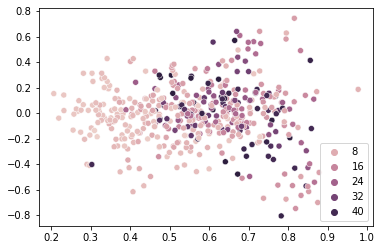

In [37]:
sns.scatterplot(s_index.flatten(), run_corr.flatten(), hue=peak.flatten())

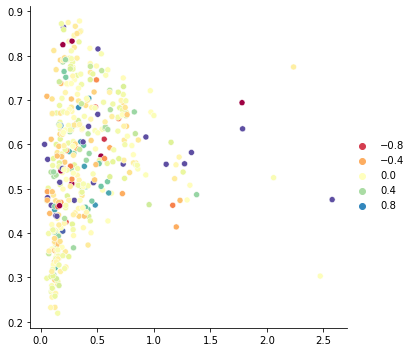

In [311]:
sns.relplot(x=((half_peak.flatten() + np.random.rand(half_peak.size) - .5)/15.5).flatten(),
            y=s_index.flatten(),
            hue=reward_history.flatten(),
            col=np.vstack([lov for s in range(11)]).T.flatten(),
            palette='Spectral')
# sns.scatterplot(x=sensory_history.flatten(), y=sensory_history_blank.flatten())

In [318]:
np.sum(~np.vstack([lov for s in range(11)]).T.flatten())

2475

## plot stages across mice (pooling mice) for the same plots 

In [ ]:
stable_mice_df = pd.concat(stable_df_list, axis=0)
stable_mice_df.head()

In [64]:
# stable_mice_df.to_pickle('/twophoton_analysis/Data/analysis/Group-attractive/stability/indices_and_modulation.pkl')
stable_mice_df = pd.read_pickle('/twophoton_analysis/Data/analysis/Group-attractive/stability/indices_and_modulation_windex.pkl')

In [ ]:
sns.displot(stable_mice_df.f1f0_sine.dropna())
np.sum(stable_mice_df.f1f0_sine.dropna().gt(10))

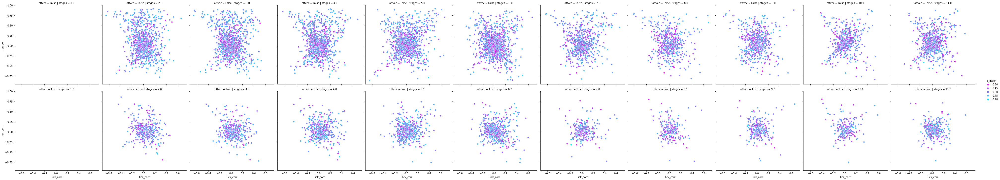

In [168]:
# stable_df_list.append(df)
        
# hue_type = 'fano_tr'
# ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'sensory_history', 'sensory_history_slow', 'sensory_history_fast']
# ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'half_peak', 'slope_sine', 'sensory_history',
#                'sensory_history_slow', 'sensory_history_fast', 'blank_history', 'reward_history', 'punish_history',
#                'running_mod', 'licking_mod']
ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'running_mod', 'licking_mod', 'punish_history', 'sensory_history',
          'lick_corr', 'lick_ons_corr']
for hue_type in ht_list:
    
    if hue_type in ['sensory_history', 'sensory_history_slow',
                    'blank_history', 'reward_history', 'running_mod', 'licking_mod',
                    'sensory_history_fast', 'corr_all', 'corr_pop', 'lick_corr', 'lick_ons_corr']:
        cmap = sns.diverging_palette(180, 300, s=100, l=55, sep=1, as_cmap=True)
        cmap = 'vlag'
    else:
        cmap = 'cool_r'
        
#     g = sns.relplot(data=stable_mice_df, x='half_peak_jitter', y='s_index', hue=hue_type, col='stages', row='offvec',
#                     alpha=1, palette=cmap)
    g = sns.relplot(data=stable_mice_df, x='lick_corr', y='run_corr', hue='s_index', col='stages', row='offvec',
                    alpha=1, palette=cmap)
#     plt.xlim([-0.1, 2])
#     g.set(xscale="log")
    
    # update axes
#     ax = g.fig.axes
#     ax = np.reshape(ax, [2, 11])
#     ax[0,0].set_ylabel('Stimulus responsive neurons\n\nSustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=14)
#     ax[1,0].set_ylabel('Offset responsive neurons\n\nSustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=14)
#     for i in range(11):
#         ax[1,i].set_xlabel('Half-peak latency,\n seconds from stimulus\nonset/offset (jittered)', size=14)
#         ax[1,i].set_xlabel('F1/F0 ratio (sin amplitude/mean response, log)', size=14)
#     ax[0,0].set_title('Stimulus responsive neurons', size=16)
#     ax[1,0].set_xlabel('Offset responsive neurons\n\nHalf-peak latency\n seconds from stimulus offset (jittered)', size=14)
#     ax[1,0].set_title('Offset responsive neurons', size=16)

    # update legend title
#     leg = g._legend
#     if hue_type == 'corr_all':
#         leg.set_title(title='correlation\n(self, trial dynamics\nover stages)')
#     elif hue_type == 'corr_pop':
#         leg.set_title(title='correlation\n(other cells,\ntrial dynamics\nsame stage)')
#     elif hue_type == 'sensory_history':
#         leg.set_title(title='sensory history\nmodulation index')
#     elif hue_type == 'fano_d':
#         leg.set_title(title='fano factor,\ncalculated on days')
#     elif hue_type == 'fano_tr':
#         leg.set_title(title='fano factor\ncalculated on trials\neach day')

#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/stability/all12_MODL_halflat_vs_SI_vs_{hue_type}_all_mice.pdf',
#                 bbox_inches='tight')

    break

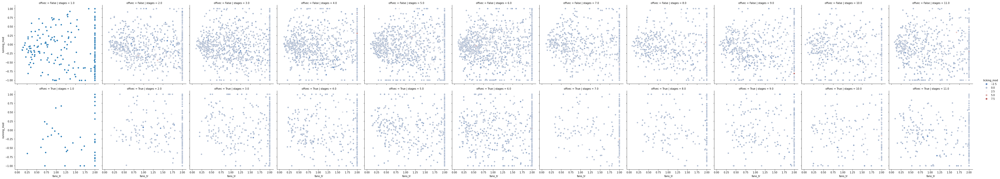

In [25]:
# g = sns.relplot(data=stable_mice_df, x='half_peak_jitter', y='s_index', hue='running_mod', col='stages', row='offvec',
#                 alpha=1, palette=cmap, vmax=0.5, vmin=-0.5)
g = sns.relplot(data=stable_mice_df, x='fano_tr', y='running_mod', hue='licking_mod', col='stages', row='offvec',
                alpha=1, palette=cmap, vmax=0.5, vmin=-0.5)
# g.set(xscale="log")

# Reversal mismatch

In [9]:
# sns.displot(meta.anticipatory_licks)
reversal_mismatch_list = []
for meta, pref_tensor, tensor in zip(meta_list, loaded_pref_tensor_list, tensor_list):
    rev = cas.mismatch.calculate_reversal_mismatch(meta, pref_tensor, filter_running=None, filter_licking=None,
                                                filter_hmm_engaged=False, force_same_day_reversal=False)
    reversal_mismatch_list.append(rev)

s:\twophoton_analysis\code\cascade\cascade\mismatch.py:82: RuntimeWarning: Mean of empty slice
s:\twophoton_analysis\code\cascade\cascade\mismatch.py:83: RuntimeWarning: Mean of empty slice


Mouse AS41 did not have any reversal.
Mouse AS47 did not have any reversal.
Mouse OA38 did not have any reversal.


In [159]:
# sns.displot(meta.anticipatory_licks)
rc_reversal_mismatch_list = []
pval_rc_boot_list = []
for meta, pref_tensor, tensor in zip(meta_list, loaded_pref_tensor_list, tensor_list):
#     rev_rc = cas.mismatch.calculate_reversal_mismatch(meta, pref_tensor, filter_running=None, filter_licking=None,
#                                                 filter_hmm_engaged=False, force_same_day_reversal=False)
    rev_rc, pv = cas.mismatch.run_controlled_reversal_mismatch(meta, pref_tensor, filter_running=None, filter_hmm_engaged=True, boot=True)
    pval_rc_boot_list.append(pv)
    rc_reversal_mismatch_list.append(rev_rc)

s:\twophoton_analysis\code\cascade\cascade\utils.py:324: RuntimeWarning: Mean of empty slice
  trace_mean = np.nanmean(tensor, axis=2)
s:\twophoton_analysis\code\cascade\cascade\utils.py:156: RuntimeWarning: Mean of empty slice
  new_mat[offset_bool, :] = np.nanmean(ablated_tensor[offset_bool, :, :][:, response_bool, :], axis=1)
s:\twophoton_analysis\code\cascade\cascade\utils.py:158: RuntimeWarning: Mean of empty slice
  new_mat[~offset_bool, :] = np.nanmean(ablated_tensor[~offset_bool, :, :][:, stim_bool, :], axis=1)
s:\twophoton_analysis\code\cascade\cascade\utils.py:1774: RuntimeWarning: Mean of empty slice
  binned_set1[:, bc] = np.nanmean(set1_tensor[:, bin_trials1], axis=1)
s:\twophoton_analysis\code\cascade\cascade\mismatch.py:114: RuntimeWarning: Mean of empty slice
  if boot:
s:\twophoton_analysis\code\cascade\cascade\mismatch.py:129: RuntimeWarning: Mean of empty slice
  for celli in range(boot_mat.shape[0]):


AS20: pre-rev: 1810, post-rev: 100
  -->  AS20: pre-rev: 1792, post-rev: 100


NameError: name 'breakpoint' is not defined

In [ ]:
test = []
mean_t_tensor = utils.tensor_mean_per_trial(meta, pref_tensor, nan_licking=False, account_for_offset=True)
for st in meta.parsed_11stage.unique():
    t = utils.bin_running_calc(meta, pref_tensor, meta.parsed_11stage.isin([st]).values, speed_type='speed')
    test.append(t)
test_stack = np.concatenate(test, axis=1)

In [ ]:
rmm_list_v1 = []
rmm_list_v2_strict = []
rmm_list_v1_hs = []
rmm_list_v2_strict_hs = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    rmm = cas.mismatch.reversal_mismatch_from_tensor(meta, tensor, model, tune_staging='staging_LR',
                                  best_tuning_only=True, drop_broad_tuning=True,
                                  staging='parsed_11stage', tuning_type='initial',
                                  filter_running=None, filter_licking=None,
                                  filter_hmm_engaged=False, force_same_day_reversal=False)
    rmm2 = cas.mismatch.reversal_mismatch_from_tensor(meta, tensor, model, tune_staging='staging_LR',
                                  best_tuning_only=True, drop_broad_tuning=True,
                                  staging='parsed_11stage', tuning_type='initial',
                                  filter_running=None, filter_licking=None,
                                  filter_hmm_engaged=False, force_same_day_reversal=True)
    
    # high speed only
    rmm_hs = cas.mismatch.reversal_mismatch_from_tensor(meta, tensor, model, tune_staging='staging_LR',
                                  best_tuning_only=True, drop_broad_tuning=True,
                                  staging='parsed_11stage', tuning_type='initial',
                                  filter_running='high_speed_only', filter_licking=None,
                                  filter_hmm_engaged=False, force_same_day_reversal=False)
    rmm2_hs = cas.mismatch.reversal_mismatch_from_tensor(meta, tensor, model, tune_staging='staging_LR',
                                  best_tuning_only=True, drop_broad_tuning=True,
                                  staging='parsed_11stage', tuning_type='initial',
                                  filter_running='high_speed_only', filter_licking=None,
                                  filter_hmm_engaged=False, force_same_day_reversal=True)
    rmm_list_v1.append(rmm)
    rmm_list_v2_strict.append(rmm2)
    rmm_list_v1_hs.append(rmm_hs)
    rmm_list_v2_strict_hs.append(rmm2_hs)

In [67]:
# get mismatch tight across reversal for low speeds 
rmm_list_v1_ls = []
# rmmtype_list_v1_ls = []
# rmm_list_v2_strict_ls = []
for meta, tensor, model in zip(meta_list, tensor_list, model_list):
    
    # high speed only
    rmm_df = cas.mismatch.reversal_mismatch_from_tensor(meta, tensor, model, tune_staging='staging_LR',
                                  best_tuning_only=True, drop_broad_tuning=True,
                                  staging='parsed_11stage', tuning_type='initial',
                                  filter_running='low_speed_only', filter_licking=None,
                                  use_stages_for_reversal=True,
                                  filter_hmm_engaged=False, force_same_day_reversal=False)
#     rmm2_ls = cas.mismatch.reversal_mismatch_from_tensor(meta, tensor, model, tune_staging='staging_LR',
#                                   best_tuning_only=True, drop_broad_tuning=True,
#                                   staging='parsed_11stage', tuning_type='initial',
#                                   filter_running='low_speed_only', filter_licking=None,
#                                   filter_hmm_engaged=False, force_same_day_reversal=True)
    rmm_list_v1_ls.append(rmm_df)
#     rmmtype_list_v1_ls.append(rmmtype)
#     rmm_list_v2_strict_ls.append(rmm2_ls)


s:\twophoton_analysis\code\cascade\cascade\utils.py:1570: RuntimeWarning: All-NaN slice encountered
  above_thresh = ~np.isnan(np.nanmax(weights, axis=1))
s:\twophoton_analysis\code\cascade\cascade\tuning.py:80: RuntimeWarning: Mean of empty slice
  trial_avg_vec = np.nanmean(cell_mat, axis=0)
s:\twophoton_analysis\code\cascade\cascade\tuning.py:358: RuntimeWarning: Mean of empty slice
  mean_cue.append(np.nanmean(rect_trial_avg_vec[cue_boo]))
s:\twophoton_analysis\code\cascade\cascade\tuning.py:410: RuntimeWarning: Mean of empty slice
  mean_cue.append(np.nanmean(rect_trial_avg_vec[cue_boo]))
s:\twophoton_analysis\code\cascade\cascade\utils.py:324: RuntimeWarning: Mean of empty slice
  trace_mean = np.nanmean(tensor, axis=2)
s:\twophoton_analysis\code\cascade\cascade\utils.py:156: RuntimeWarning: Mean of empty slice
  new_mat[offset_bool, :] = np.nanmean(ablated_tensor[offset_bool, :, :][:, response_bool, :], axis=1)
s:\twophoton_analysis\code\cascade\cascade\utils.py:158: RuntimeWarn

Mouse AS41 did not have any reversal.
Mouse AS47 did not have any reversal.
Mouse OA38 did not have any reversal.


In [65]:
rmm_list_v1_ls

NameError: name 'rmm_list_v1_ls' is not defined

In [37]:
rmm_df_all = pd.concat([rm for rm in rmm_list_v1_ls if isinstance(rm, pd.DataFrame)], axis=0)

In [152]:
# copy your mismatch across stages for plotting
expanded_rmm = []
for rmmi in rc_reversal_mismatch_list:
    
    # replicate rMM for each stage
    if isinstance(rmmi, pd.DataFrame):
        col = rmmi.mismatch_response
        expanded_rmm.append(np.vstack([col for s in range(11)]).T.flatten())
    else:
        expanded_rmm.append(np.vstack([rmmi for s in range(11)]).T.flatten())
    
expanded_rmm = np.hstack(expanded_rmm)

simple_thresh_rmm = np.zeros(len(expanded_rmm))
simple_thresh_rmm[:] = np.nan
simple_thresh_rmm[(expanded_rmm < 0.25) & (expanded_rmm > -0.25)] = 0
simple_thresh_rmm[expanded_rmm > 0.25] = 0.25
simple_thresh_rmm[expanded_rmm < -0.25] = -0.25
simple_thresh_rmm[expanded_rmm > 0.5] = 0.5
simple_thresh_rmm[expanded_rmm < -0.5] = -0.5
simple_thresh_rmm[expanded_rmm > 1] = 1
simple_thresh_rmm[expanded_rmm < -1] = -1


In [154]:
expanded_boot = []
for rmmi in pval_rc_boot_list:
    
    # replicate rMM for each stage
    if isinstance(rmmi, pd.DataFrame):
        col = rmmi.mismatch_response
        expanded_boot.append(np.vstack([col for s in range(11)]).T.flatten())
    else:
        expanded_boot.append(np.vstack([rmmi for s in range(11)]).T.flatten())
    
expanded_boot = np.hstack(expanded_rmm)

In [63]:
# g = sns.relplot(data=stable_mice_df, x=expanded_rmm, y='punish_history', hue='peak', col='stages', row='offvec',
#                 alpha=1, palette='icefire')
g = sns.relplot(data=stable_mice_df, x='s_index', y=expanded_rmm, hue='run_corr', col='stages', row='offvec',
                alpha=1, palette='viridis')

axes = g.axes
for ax in axes.flatten():
    ax.axhline(0, color='red', linestyle=':')
    ax.axvline(0, color='red', linestyle=':')
    
axes[0][0].set_ylabel('Stimulus cells:\nReversal mismatch response (z-score)', size=14)
axes[1][0].set_ylabel('Offset cells:\nReversal mismatch response (z-score)', size=14)

for ax in axes[1]:
    ax.set_xlabel('Sustainedness (mean / 95th percentile)\ntransient <-------> sustained', size=14)
    
    
g = sns.relplot(data=stable_mice_df, x='run_corr', y=expanded_rmm, hue=expanded_boot < 0.5, col='stages', row='offvec',
                alpha=1, palette='viridis')
axes = g.axes
for ax in axes.flatten():
    ax.axhline(0, color='red', linestyle=':')
    ax.axvline(0, color='red', linestyle=':')
    

axes[0][0].set_ylabel('Stimulus cells:\nReversal mismatch response (z-score)', size=14)
axes[1][0].set_ylabel('Offset cells:\nReversal mismatch response (z-score)', size=14)

for ax in axes[1]:
    ax.set_xlabel('Trial-to-trial correlation\nwith running speed', size=14)
#     ax.set_xlabel('Single trial amplitude correlation\nwith running speed', size=14)

    
# plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/stability/rMM_lowspeed_vs_runcorr_sindex_all_mice.pdf',
#                 bbox_inches='tight')

NameError: name 'stable_mice_df' is not defined

In [97]:
# get mean of stimulus and offset
onset = []
offset = []
for meta, tensor, model in zip(meta_list, loaded_pref_tensor_list, model_list):
    a, b = cas.stability.mean_stim_and_response(meta, tensor)
    onset.append(a)
    offset.append(b)

s:\twophoton_analysis\code\cascade\cascade\utils.py:50: RuntimeWarning: Mean of empty slice
  new_tensor[:, :, c] = np.nanmean(tensor[:, :, stage_boo], axis=2)
s:\twophoton_analysis\code\cascade\cascade\stability.py:1106: RuntimeWarning: Mean of empty slice
  offset_response = np.nanmean(mean_tensor[:, response_window, :], axis=1)
s:\twophoton_analysis\code\cascade\cascade\stability.py:1107: RuntimeWarning: Mean of empty slice
  stimulus_response = np.nanmean(mean_tensor[:, stimulus_window, :], axis=1)


## KDE density plots

D:\Anaconda3\lib\site-packages\seaborn\distributions.py:1184: UserWarning: The following kwargs were not used by contour: 'stat'
  **contour_kws,


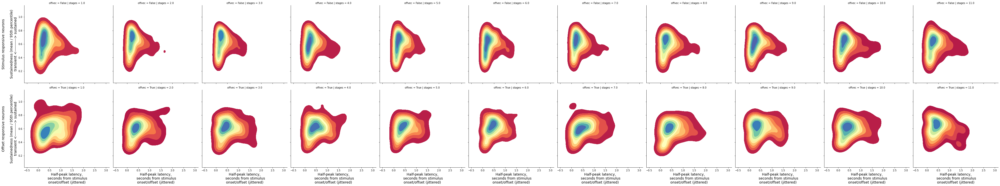

In [144]:
stable_df_list.append(df)
        
# hue_type = 'fano_tr'
ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'sensory_history']
for hue_type in ht_list:

    g = sns.displot(data=stable_mice_df, x='half_peak_jitter', y='s_index', #hue=hue_type,
                    stat='probability', common_norm=False,  #binwidth=0.05, 
                    col='stages', row='offvec', cmap='Spectral', kind='kde', fill=True)
    
    
    # update axes
    ax = g.fig.axes
    ax = np.reshape(ax, [2, int(len(ax)/2)])
    ax[0,0].set_ylabel('Stimulus responsive neurons\n\nSustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=14)
    ax[1,0].set_ylabel('Offset responsive neurons\n\nSustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=14)
    for i in range(11):
        ax[1,i].set_xlabel('Half-peak latency,\n seconds from stimulus\nonset/offset (jittered)', size=14)
#     ax[0,0].set_title('Stimulus responsive neurons', size=16)
#     ax[1,0].set_xlabel('Offset responsive neurons\n\nHalf-peak latency\n seconds from stimulus offset (jittered)', size=14)
#     ax[1,0].set_title('Offset responsive neurons', size=16)

    # update legend title
#     leg = g._legend
#     if hue_type == 'corr_all':
#         leg.set_title(title='correlation\n(self, trial dynamics\nover stages)')
#     elif hue_type == 'corr_pop':
#         leg.set_title(title='correlation\n(other cells,\ntrial dynamics\nsame stage)')
#     elif hue_type == 'sensory_history':
#         leg.set_title(title='sensory history\nmodulation index')
#     elif hue_type == 'fano_d':
#         leg.set_title(title='fano factor,\ncalculated on days')
#     elif hue_type == 'fano_tr':
#         leg.set_title(title='fano factor\ncalculated on trials\neach day')

    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/stability/all12_halfpeaklat_vs_SI_vs_KDE_all_mice.pdf',
                bbox_inches='tight')

    break

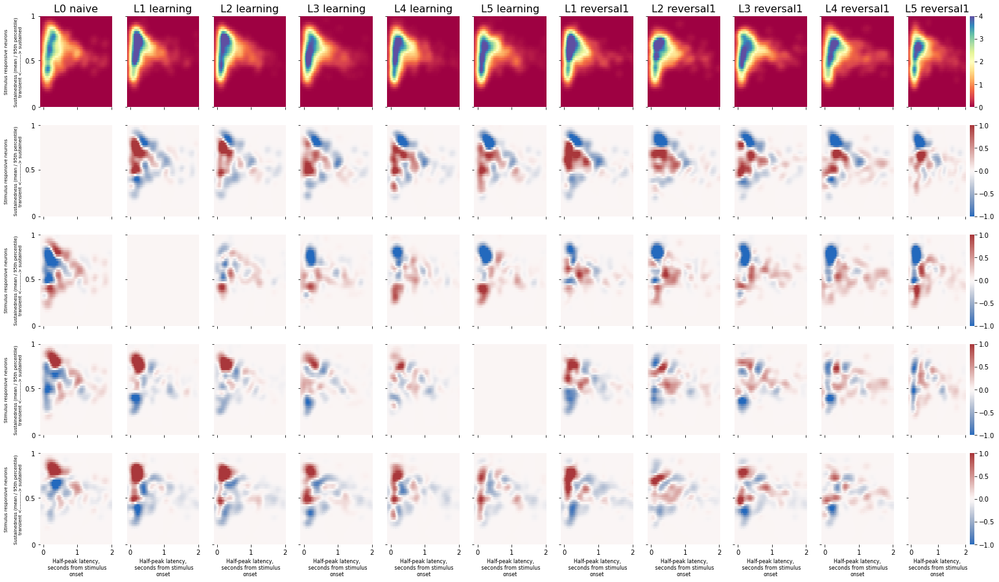

In [266]:
import scipy.stats as sps

# estimate kernel density of data
# kde = sps.gaussian_kde(stable_mice_df.loc[:, ['half_peak', 's_index']].values.T)

fig, ax = plt.subplots(5,11, figsize=(26,15), sharex=True, sharey=True)
ax = np.reshape(ax, [5, 11])
for i in range(1,12):
    
    kde_learn = sps.gaussian_kde(stable_mice_df.loc[(stable_mice_df.stages.isin([6]) & ~stable_mice_df.offvec),
                                                    ['half_peak', 's_index']].dropna().values.T, .25)
    kde_rev = sps.gaussian_kde(stable_mice_df.loc[(stable_mice_df.stages.isin([11])& ~stable_mice_df.offvec),
                                                  ['half_peak', 's_index']].dropna().values.T, .25)
    kde_l1 = sps.gaussian_kde(stable_mice_df.loc[(stable_mice_df.stages.isin([2]) & ~stable_mice_df.offvec),
                                                    ['half_peak', 's_index']].dropna().values.T, .25)
    kde_l0 = sps.gaussian_kde(stable_mice_df.loc[(stable_mice_df.stages.isin([1])& ~stable_mice_df.offvec),
                                                  ['half_peak', 's_index']].dropna().values.T, .25)
    kde = sps.gaussian_kde(stable_mice_df.loc[(stable_mice_df.stages.isin([i]) & ~stable_mice_df.offvec),
                                              ['half_peak', 's_index']].dropna().values.T, .25)

    # get a regular grid of points over our region of interest
    xrange = np.arange(-.1, 2.025, 0.025)
    yrange = np.arange(0, 1.025, 0.025)
    xx, yy = np.meshgrid(xrange, yrange)

    positions = np.vstack([xx.ravel(), yy.ravel()])

    # calculate probability density on these points
    z = kde.pdf([xx.ravel(), yy.ravel()]).reshape(xx.shape)
    z_rev = kde_rev.pdf([xx.ravel(), yy.ravel()]).reshape(xx.shape)
    z_learn = kde_learn.pdf([xx.ravel(), yy.ravel()]).reshape(xx.shape)
    z_l0 = kde_l0.pdf([xx.ravel(), yy.ravel()]).reshape(xx.shape)
    z_l1 = kde_l1.pdf([xx.ravel(), yy.ravel()]).reshape(xx.shape)

    Z = np.reshape(kde(positions).T, xx.shape)
    Z_rev = np.reshape(kde_rev(positions).T, xx.shape)
    Z_learn = np.reshape(kde_learn(positions).T, xx.shape)
    Z_l0 = np.reshape(kde_l0(positions).T, xx.shape)
    Z_l1 = np.reshape(kde_l1(positions).T, xx.shape)
    
    sns.heatmap(z[::-1,:], cmap='Spectral', ax=ax[0, i-1], vmin=0, vmax=4, cbar=True if i % 11 == 0 else False)
    sns.heatmap((Z - Z_l0)[::-1,:], cmap='vlag', ax=ax[1, i-1], vmin=-1, vmax=1, center=0, cbar=True if i % 11 == 0 else False)
    sns.heatmap((Z - Z_l1)[::-1,:], cmap='vlag', ax=ax[2, i-1], vmin=-1, vmax=1, center=0, cbar=True if i % 11 == 0 else False)
    sns.heatmap((Z - Z_learn)[::-1,:], cmap='vlag', ax=ax[3, i-1], vmin=-1, vmax=1, center=0, cbar=True if i % 11 == 0 else False)
    sns.heatmap((Z - Z_rev)[::-1,:], cmap='vlag', ax=ax[4, i-1], vmin=-1, vmax=1, center=0, cbar=True if i % 11 == 0 else False)
    
    this = cas.lookups.staging['parsed_11stage'][i-1]
    ax[0, i-1].set_title(f'{this}', size=16)
    ax[-1, i-1].set_xlabel('Half-peak latency,\n seconds from stimulus\nonset', size=8)
    ax[-1, i-1].set_xticks([4, 44, 84])
    ax[-1, i-1].set_xticklabels([0, 1, 2], rotation=0)
    for k in range(5):
        ax[k,0].set_ylabel('Stimulus responsive neurons\n\nSustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=7)
        ax[k,0].set_yticks([0, 20, 41])
        ax[k,0].set_yticklabels([1, 0.5, 0])

plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/stability/all12_halfpeaklat_diffKDE_all_mice.pdf',
                bbox_inches='tight')
#     ax[0, i-1].contourf(Z)
#     ax[1, i-1].contourf((Z - Z_learn), cmap='icefire', vmin=-1, vmax=1, center=0)
#     ax[2, i-1].contourf((Z - Z_rev), cmap='icefire', vmin=-1, vmax=1, center=0)

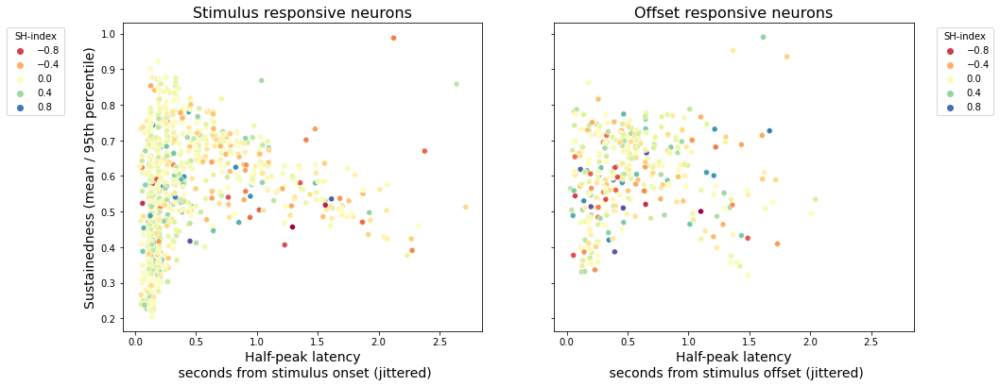

In [21]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6), sharex=True, sharey=True)
stage_colors = np.ones(half_peak.shape)
stage_colors = stage_colors*np.arange(1, 12)
sns.scatterplot(x=(half_peak[~offvec, :].flatten() + np.random.randn(half_peak[~offvec, :].size)/5)/15.5,
                y=s_index[~offvec, :].flatten(),
                hue=sensory_history[~offvec, :].flatten(), palette='Spectral', ax=ax[0])
ax[0].set_ylabel('Sustainedness (mean / 95th percentile)', size=14)
ax[0].set_xlabel('Half-peak latency\n seconds from stimulus onset (jittered)', size=14)
ax[0].set_title('Stimulus responsive neurons', size=16)
ax[0].legend(title='SH-index', loc=1, bbox_to_anchor=(-0.15, 1))

sns.scatterplot(x=(half_peak[offvec, :].flatten() + np.random.randn(half_peak[offvec, :].size)/5)/15.5,
                y=s_index[offvec, :].flatten(),
                hue=sensory_history[offvec, :].flatten(), palette='Spectral', ax=ax[1])
ax[1].set_xlabel('Half-peak latency\n seconds from stimulus offset (jittered)', size=14)
ax[1].set_title('Offset responsive neurons', size=16)
ax[1].legend(title='SH-index', loc=2, bbox_to_anchor=(1.05, 1))

# for ss in range(11):
#     plt.figure(figsize=(10, 8))
#     sns.regplot(half_peak[~offvec, ss].flatten(), s_index[~offvec, ss].flatten(), scatter=True)
# plt.ylim([-0.1, 1.1])

D:\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
D:\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


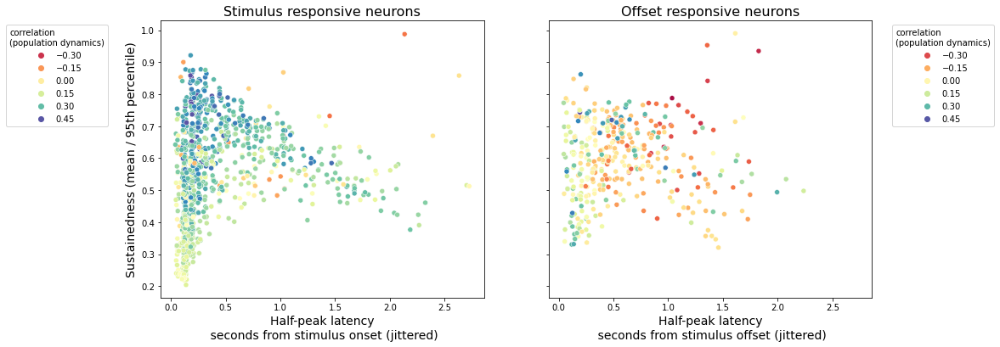

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6), sharex=True, sharey=True)
stage_colors = np.ones(half_peak.shape)
stage_colors = stage_colors*np.arange(1, 12)
sns.scatterplot((half_peak[~offvec, :].flatten() + np.random.randn(half_peak[~offvec, :].size)/5)/15.5,
                s_index[~offvec, :].flatten(),
                hue=corr_pop[~offvec, :].flatten(), palette='Spectral', ax=ax[0])
ax[0].set_ylabel('Sustainedness (mean / 95th percentile)', size=14)
ax[0].set_xlabel('Half-peak latency\n seconds from stimulus onset (jittered)', size=14)
ax[0].set_title('Stimulus responsive neurons', size=16)
# handles, labels = ax[0].get_legend_handles_labels()
ax[0].legend(title='correlation\n(population dynamics)', loc=1, bbox_to_anchor=(-0.15, 1))

sns.scatterplot((half_peak[offvec, :].flatten() + np.random.randn(half_peak[offvec, :].size)/5)/15.5,
                s_index[offvec, :].flatten(),
                hue=corr_pop[offvec, :].flatten(), palette='Spectral', ax=ax[1])
ax[1].set_xlabel('Half-peak latency\n seconds from stimulus offset (jittered)', size=14)
ax[1].set_title('Offset responsive neurons', size=16)
# handles, labels = ax[1].get_legend_handles_labels()
ax[1].legend(title='correlation\n(population dynamics)', loc=2, bbox_to_anchor=(1.05, 1))


D:\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
D:\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


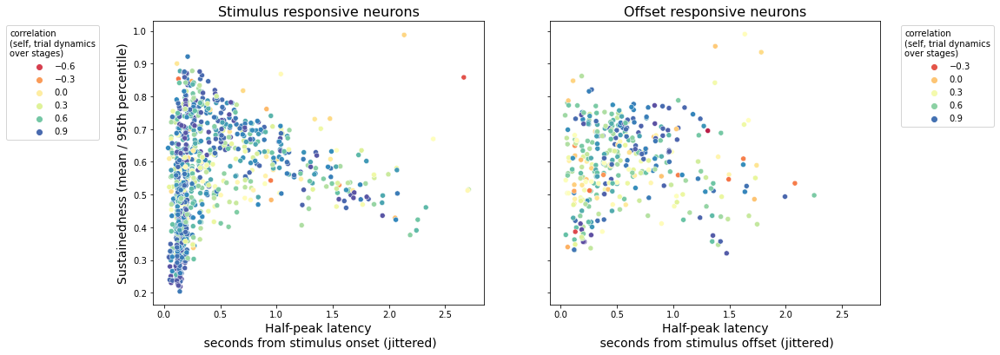

In [13]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6), sharex=True, sharey=True)
stage_colors = np.ones(half_peak.shape)
stage_colors = stage_colors*np.arange(1, 12)
sns.scatterplot((half_peak[~offvec, :].flatten() + np.random.randn(half_peak[~offvec, :].size)/5)/15.5,
                s_index[~offvec, :].flatten(),
                hue=corr_all[~offvec, :].flatten(), palette='Spectral', ax=ax[0])
ax[0].set_ylabel('Sustainedness (mean / 95th percentile)', size=14)
ax[0].set_xlabel('Half-peak latency\n seconds from stimulus onset (jittered)', size=14)
ax[0].set_title('Stimulus responsive neurons', size=16)
# handles, labels = ax[0].get_legend_handles_labels()
ax[0].legend(title='correlation\n(self, trial dynamics\nover stages)', loc=1, bbox_to_anchor=(-0.15, 1))

sns.scatterplot((half_peak[offvec, :].flatten() + np.random.randn(half_peak[offvec, :].size)/5)/15.5,
                s_index[offvec, :].flatten(),
                hue=corr_all[offvec, :].flatten(), palette='Spectral', ax=ax[1], vmin=-1, vmax=1)
ax[1].set_xlabel('Half-peak latency\n seconds from stimulus offset (jittered)', size=14)
ax[1].set_title('Offset responsive neurons', size=16)
# handles, labels = ax[1].get_legend_handles_labels()
# handles=handles, labels=[round(float(s),2) for s in labels]
ax[1].legend(title='correlation\n(self, trial dynamics\nover stages)', loc=2, bbox_to_anchor=(1.05, 1))


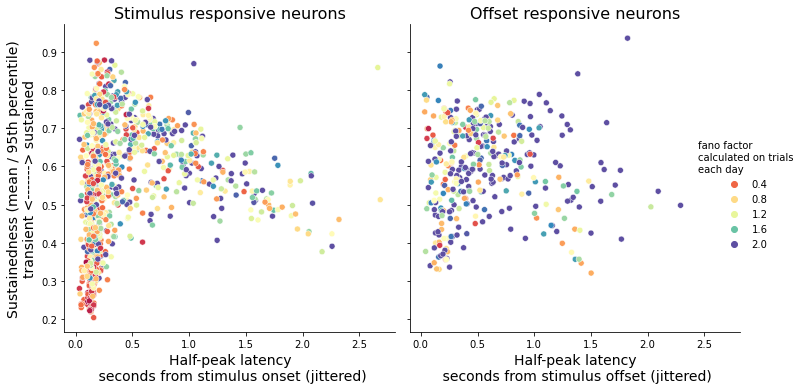

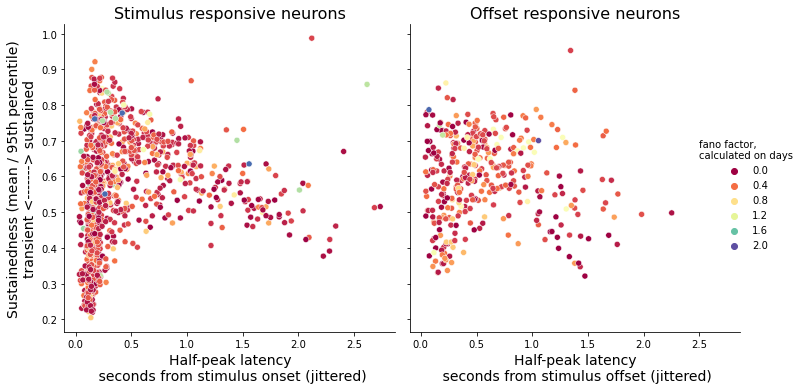

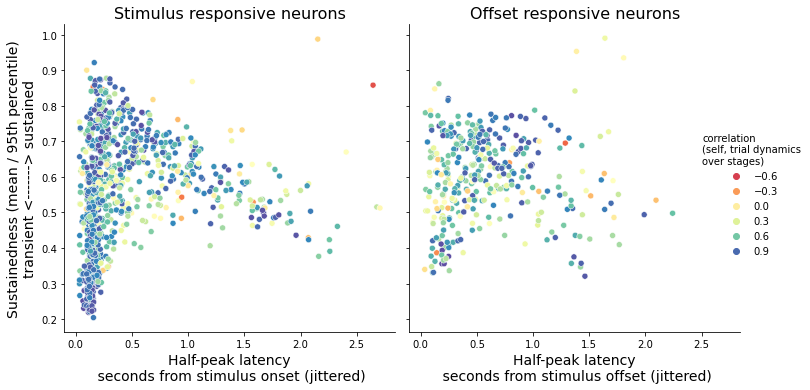

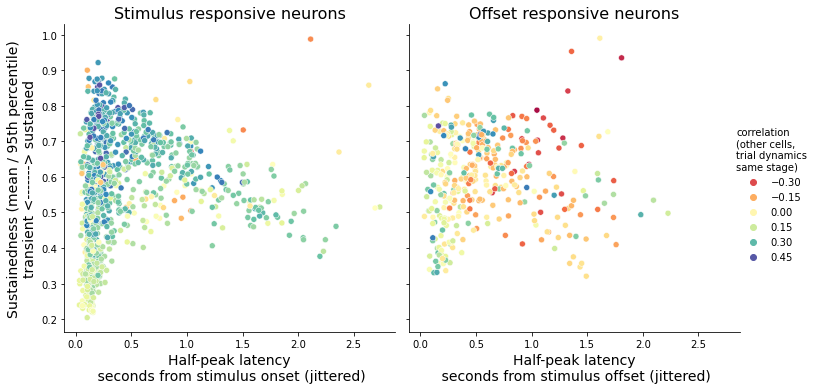

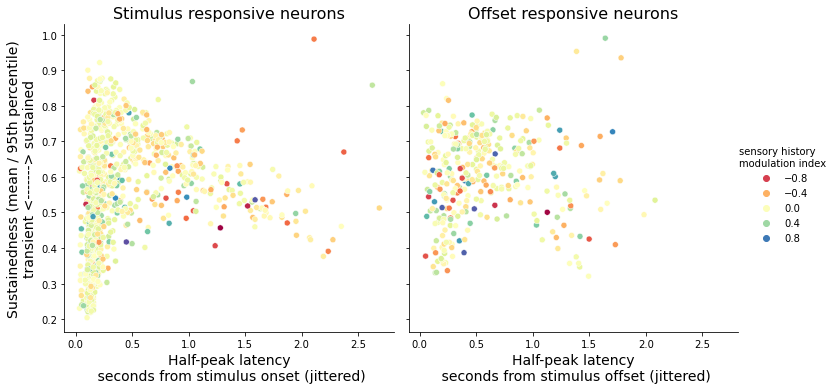

In [45]:
# hue_type = 'fano_tr'
ht_list = ['fano_tr', 'fano_d', 'corr_all', 'corr_pop', 'sensory_history']
for hue_type in ht_list:
    
    # list of offset boolean to be duplicated across stages
    lov = list(offvec)

    # list for visualizing fano_d
    vis_fano_d = deepcopy(fano_d)
    vis_fano_d[vis_fano_d > 2] = 2
    lfano = list(vis_fano_d)

    # visualize fano_tr
    vis_fano_tr = deepcopy(fano_tr)
    vis_fano_tr[vis_fano_tr > 2] = 2

    # stage labels, numeric
    stage_colors = np.ones(half_peak.shape)
    stage_colors = stage_colors*np.arange(1, 12)

    df = pd.DataFrame(data={'half_peak': half_peak.flatten()/15.5,
                            'half_peak_jitter': (half_peak.flatten() + np.random.rand(half_peak.size) - .5)/15.5,
                            's_index': s_index.flatten(),
                            'corr_all': corr_all.flatten(),
                            'corr_pop': corr_pop.flatten(),
                            'fano_d': np.vstack([lfano for s in range(11)]).T.flatten(),
                            'fano_tr': vis_fano_tr.flatten(),
                            'sensory_history': sensory_history.flatten(),
                            'offvec': np.vstack([lov for s in range(11)]).T.flatten(),
                            'stages': stage_colors.flatten()})
    g = sns.relplot(data=df, x='half_peak_jitter', y='s_index', hue=hue_type, col='offvec', palette='Spectral')

    # update axes
    ax = g.fig.axes
    ax[0].set_ylabel('Sustainedness (mean / 95th percentile)\ntransient <-----------> sustained', size=14)
    ax[0].set_xlabel('Half-peak latency\n seconds from stimulus onset (jittered)', size=14)
    ax[0].set_title('Stimulus responsive neurons', size=16)
    ax[1].set_xlabel('Half-peak latency\n seconds from stimulus offset (jittered)', size=14)
    ax[1].set_title('Offset responsive neurons', size=16)

    # update legend title
    leg = g._legend
    if hue_type == 'corr_all':
        leg.set_title(title='correlation\n(self, trial dynamics\nover stages)')
    elif hue_type == 'corr_pop':
        leg.set_title(title='correlation\n(other cells,\ntrial dynamics\nsame stage)')
    elif hue_type == 'sensory_history':
        leg.set_title(title='sensory history\nmodulation index')
    elif hue_type == 'fano_d':
        leg.set_title(title='fano factor,\ncalculated on days')
    elif hue_type == 'fano_tr':
        leg.set_title(title='fano factor\ncalculated on trials\neach day')

    plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/stability/all12_halfpeaklat_vs_SI_vs_{hue_type}_{mouse}.pdf',
                bbox_inches='tight')


s:\twophoton_analysis\code\cascade\cascade\utils.py:50: RuntimeWarning: Mean of empty slice
  new_tensor[:, :, c] = np.nanmean(tensor[:, :, stage_boo], axis=2)


Text(0.5, 1, 'DFF (z-score)')

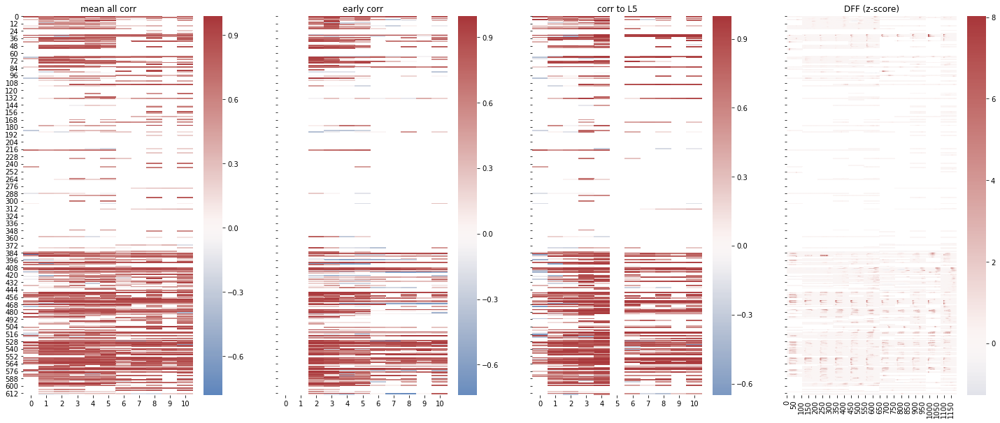

In [546]:
fig, ax = plt.subplots(1,4, figsize=(25,10), sharey=True)
sns.heatmap(corr_all, ax=ax[0], cmap='vlag', center=0)
ax[0].set_title('mean all corr')
sns.heatmap(corr_early, ax=ax[1], cmap='vlag', center=0)
ax[1].set_title('early corr')
sns.heatmap(corr_L5, ax=ax[2], cmap='vlag', center=0)
ax[2].set_title('corr to L5')
sns.heatmap(utils.unwrap_tensor(utils.simple_mean_per_stage(meta, pref_tensor)), ax=ax[3], cmap='vlag', center=0)
ax[3].set_title('DFF (z-score)')


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: Mean of empty slice
  """Entry point for launching an IPython kernel.
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: Mean of empty slice
  


[Text(0, 0, 'L0 naive'),
 Text(0, 0, 'L1 learning'),
 Text(0, 0, 'L2 learning'),
 Text(0, 0, 'L3 learning'),
 Text(0, 0, 'L4 learning'),
 Text(0, 0, 'L5 learning'),
 Text(0, 0, 'L1 reversal1'),
 Text(0, 0, 'L2 reversal1'),
 Text(0, 0, 'L3 reversal1'),
 Text(0, 0, 'L4 reversal1'),
 Text(0, 0, 'L5 reversal1')]

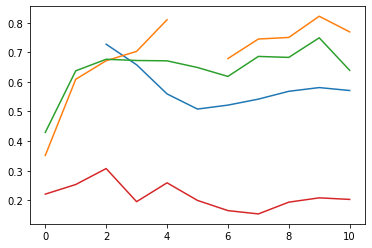

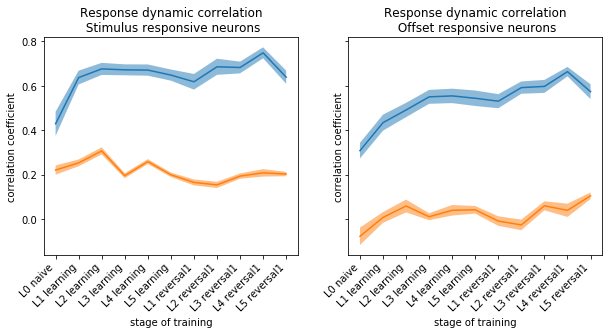

In [687]:
plt.plot(np.nanmean(corr_early[~offvec, :], 0))
plt.plot(np.nanmean(corr_L5[~offvec, :], 0))
plt.plot(np.nanmean(corr_all[~offvec, :], 0))
plt.plot(np.nanmean(corr_pop[~offvec, :], 0))

fig, ax = plt.subplots(1,2, figsize=(10, 4), sharey=True)

y_est = np.nanmean(corr_all[~offvec, :], axis=0)
ax[0].plot(np.arange(11), np.nanmean(corr_all[~offvec, :], axis=0), label='correlation to self, other stages')
sem = np.nanstd(corr_all[~offvec, :], axis=0)/np.sqrt(np.sum(~np.isnan(corr_all[~offvec, :]), axis=0))
ax[0].fill_between(np.arange(11), y_est-sem, y_est+sem, alpha=0.5)

y_est = np.nanmean(corr_pop[~offvec, :], axis=0)
ax[0].plot(np.arange(11), np.nanmean(corr_pop[~offvec, :], axis=0), label='correlation to other cells, same stages')
sem = np.nanstd(corr_pop[~offvec, :], axis=0)/np.sqrt(np.sum(~np.isnan(corr_pop[~offvec, :]), axis=0))
ax[0].fill_between(np.arange(11), y_est-sem, y_est+sem, alpha=0.5)

ax[0].set_title('Response dynamic correlation\n Stimulus responsive neurons')
ax[0].set_ylabel('correlation coefficient')
ax[0].set_xlabel('stage of training')
ax[0].set_xticks(np.arange(11))
ax[0].set_xticklabels(cas.lookups.staging['parsed_11stage'], rotation=45, ha='right')

y_est = np.nanmean(corr_all[offvec, :], axis=0)
ax[1].plot(np.arange(11), np.nanmean(corr_all[offvec, :], axis=0), label='correlation to self, other stages')
sem = np.nanstd(corr_all[offvec, :], axis=0)/np.sqrt(np.sum(np.isnan(corr_all[offvec, :]), axis=0))
ax[1].fill_between(np.arange(11), y_est-sem, y_est+sem, alpha=0.5)

y_est = np.nanmean(corr_pop[offvec, :], axis=0)
ax[1].plot(np.arange(11), np.nanmean(corr_pop[offvec, :], axis=0), label='correlation to other cells, same stages')
sem = np.nanstd(corr_pop[offvec, :], axis=0)/np.sqrt(np.sum(~np.isnan(corr_pop[offvec, :]), axis=0))
ax[1].fill_between(np.arange(11), y_est-sem, y_est+sem, alpha=0.5)

ax[1].set_title('Response dynamic correlation\n Offset responsive neurons')
ax[1].set_ylabel('correlation coefficient')
ax[1].set_xlabel('stage of training')
ax[1].set_xticks(np.arange(11))
ax[1].set_xticklabels(cas.lookups.staging['parsed_11stage'], rotation=45, ha='right')

Text(0.5, 1, 'DFF (z-score)')

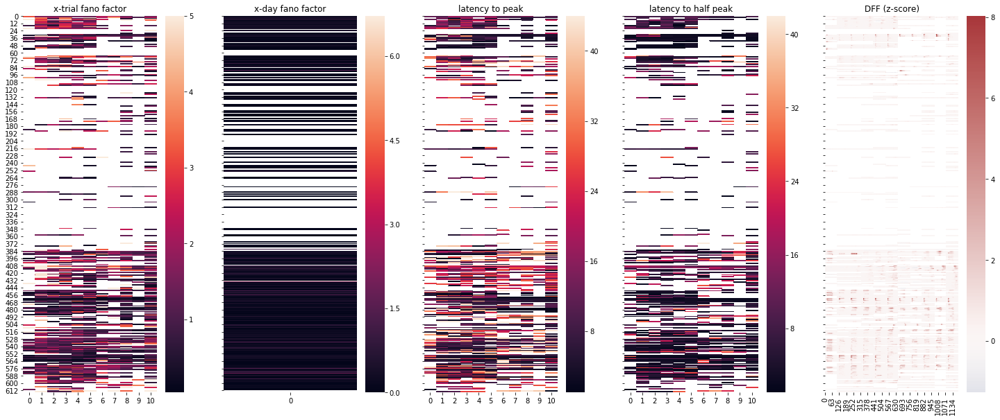

In [503]:
fig, ax = plt.subplots(1,5, figsize=(25,10), sharey=True)
sns.heatmap(fano_tr, ax=ax[0], vmax=5)
ax[0].set_title('x-trial fano factor')
sns.heatmap(fano_d[:,None], ax=ax[1])
ax[1].set_title('x-day fano factor')
sns.heatmap(peak, ax=ax[2])
ax[2].set_title('latency to peak')
sns.heatmap(half_peak, ax=ax[3])
ax[3].set_title('latency to half peak')
sns.heatmap(utils.unwrap_tensor(utils.simple_mean_per_stage(meta, pref_tensor)), ax=ax[4], cmap='vlag', center=0)
ax[4].set_title('DFF (z-score)')

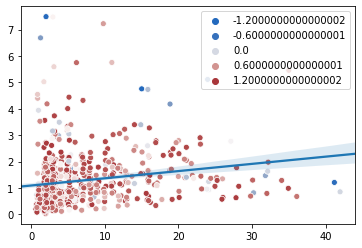

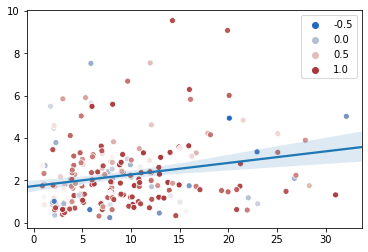

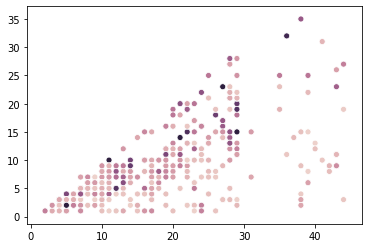

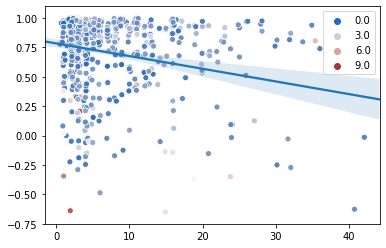

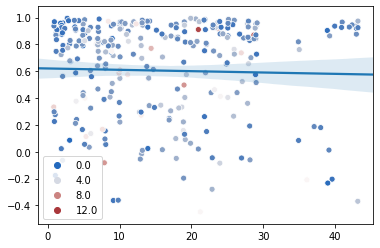

In [545]:
fano2 = deepcopy(fano_tr)
fano2[fano2 > 10] = np.nan
plt.figure()
# for ss in range(peak.shape[1]):
#     sns.scatterplot(half_peak[~offvec, ss]+np.random.randn(np.sum(~offvec))/6, fano2[~offvec, ss], hue=corr_all[~offvec, ss],
#                     legend=False)
sns.scatterplot(half_peak[~offvec, :].flatten() + np.random.randn(half_peak[~offvec, :].size)/6,
                fano2[~offvec, :].flatten(),
                hue=corr_L5[~offvec, :].flatten(), palette='vlag')  
sns.regplot(half_peak[~offvec, :].flatten(), fano2[~offvec, :].flatten(), scatter=False)
    
plt.figure()
# for ss in range(peak.shape[1]):
#     sns.scatterplot(half_peak[offvec, ss]+np.random.randn(np.sum(offvec))/6, fano2[offvec, ss], hue=corr_all[offvec, ss],
#                     legend=False, palette='icefire')
sns.scatterplot(half_peak[offvec, :].flatten() + np.random.randn(half_peak[offvec, :].size)/6,
                fano2[offvec, :].flatten(),
                hue=corr_L5[offvec, :].flatten(), palette='vlag')  
sns.regplot(half_peak[offvec, :].flatten(), fano2[offvec, :].flatten(), scatter=False)
    
plt.figure()
for ss in range(peak.shape[1]):
    sns.scatterplot(peak[offvec, ss], half_peak[offvec, ss], hue=fano2[offvec, ss],
                    legend=False)
    
plt.figure()
sns.scatterplot(half_peak[~offvec, :].flatten() + np.random.randn(half_peak[~offvec, :].size)/6,
                corr_L5[~offvec, :].flatten(),
                hue=fano2[~offvec, :].flatten(), palette='vlag')  
sns.regplot(half_peak[~offvec, :].flatten(), corr_L5[~offvec, :].flatten(), scatter=False)

plt.figure()
sns.scatterplot(peak[offvec, :].flatten() + np.random.randn(peak[offvec, :].size)/6,
                corr_L5[offvec, :].flatten(),
                hue=fano2[offvec, :].flatten(), palette='vlag')  
sns.regplot(peak[offvec, :].flatten(), corr_L5[offvec, :].flatten(), scatter=False)
    

In [ ]:
meta.loc[:, ['orientation', 'condition', 'initial_condition', 'trialerror',
       'prev_reward', 'prev_punish', 'prev_same_plus', 'prev_same_neutral',
       'prev_same_minus', 'learning_state', 
       'firstlick', 'firstlickbout', 'ensure', 'quinine', 'anticipatory_licks', 'pre_licks', 'go', 'reward', 'punishment']]

In [68]:
pd.cut(meta.speed, np.arange(0, 100, 3), include_lowest=True, labels=np.arange(0, 100, 3)[:-1]).values

[0, 15, 12, 33, 24, ..., 63, 66, 69, 75, 72]
Length: 27
Categories (26, int64): [0 < 3 < 6 < 9 ... 66 < 69 < 72 < 75]

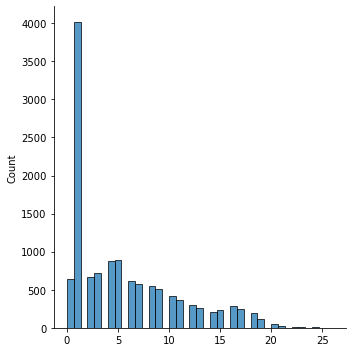

In [73]:
sns.displot(np.digitize(meta.speed, np.arange(0, 100, 3), right=True))

In [ ]:
vec = np.rand
fano = np.nanvar(unwind, axis=1)/np.nanmean(unwind, axis=1)

In [ ]:
mean_tensor = utils.simple_mean_per_day(meta, pt)
unwind = utils.unwrap_tensor(mean_tensor)

In [404]:
fano = np.abs(np.nanvar(unwind, axis=1)/np.nanmean(unwind, axis=1))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: Degrees of freedom <= 0 for slice.
  """Entry point for launching an IPython kernel.
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: Mean of empty slice
  """Entry point for launching an IPython kernel.


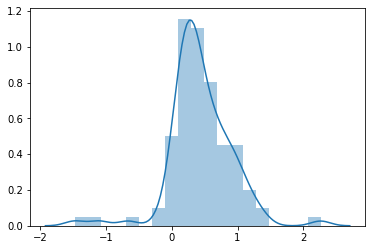

In [358]:
sns.distplot(fano[~np.isnan(fano)])

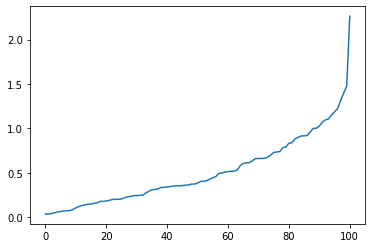

In [406]:
plt.plot(np.sort(fano))

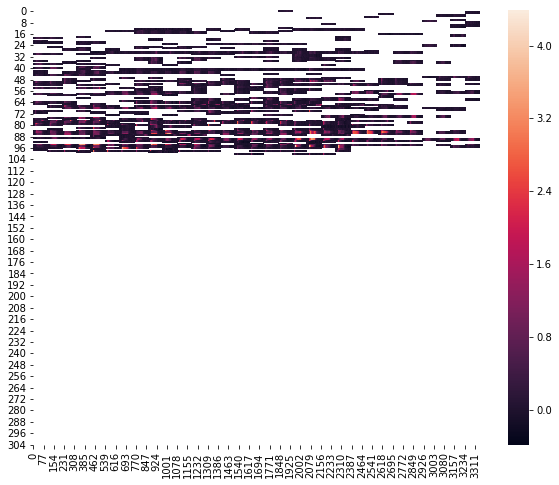

In [405]:
plt.figure(figsize=(10, 8))
sns.heatmap(unwind[np.argsort(fano), :])

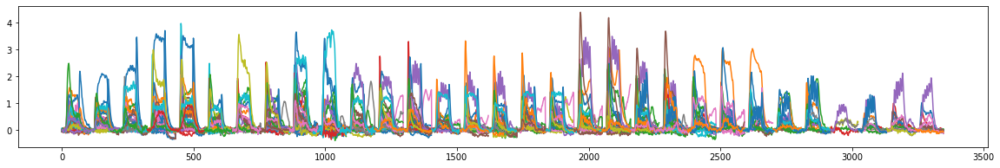

In [362]:
plt.figure(figsize=(20, 3))
plt.plot(unwind.T);

In [518]:
np.array([1, 2, 3])[0:2]

array([1, 2])

### heirarchical clustering for sorting

In [ ]:
mean_cosd = np.nanmean(np.concatenate([s[:,:, None] for s in scos], 2), 2)
mean_cosd[np.isnan(mean_cosd)] = -1
sns.heatmap(mean_cosd)
g = sns.clustermap(mean_cosd)
clus_sort = g.dendrogram_row.reordered_ind

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: All-NaN slice encountered


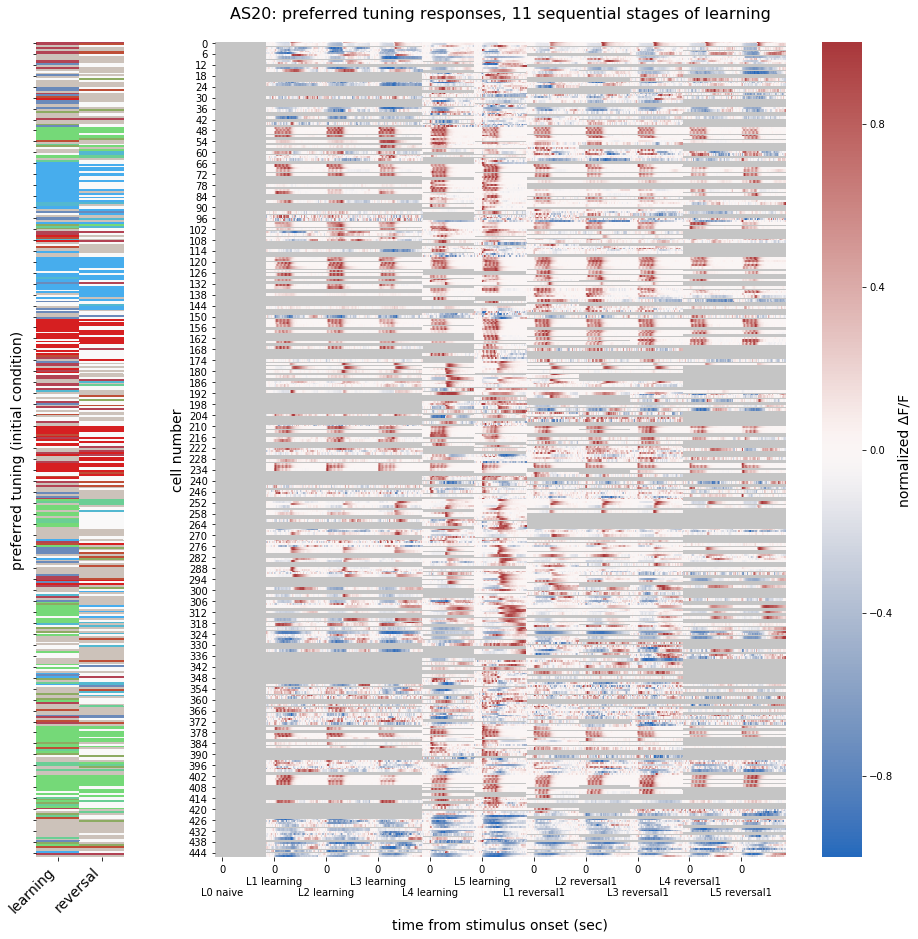

In [217]:
norm_row = True
# sorter = clus_sort

# allow for mapping between digits and colors (rather than tuning strings to colors)
possible_tuning = ['broad', 'minus', 'minus-neutral', 'minus-plus', 'neutral',
       'neutral-minus', 'neutral-plus', 'none', 'plus', 'plus-minus',
       'plus-neutral']
color_mapper = {} # map numbers to colors
list_mapper = {} # map colors to numbers
counter = 0
for k,v in cas.lookups.color_dict.items():
    if k not in possible_tuning:
        continue
    color_mapper[counter] = v
    list_mapper[k] = counter
    counter += 1

# map
tune_l1 = []
for s1 in stune:
    tune_l2 = []
    for s2 in s1:
        tune_l2.append(list_mapper[s2])
    tune_l1.append(tune_l2)
number_tune_mat = np.vstack(tune_l1)

ax = []
fig = plt.figure(figsize=(16, 15))
gs = fig.add_gridspec(100, 100)
ax.append(fig.add_subplot(gs[:, :10]))
ax.append(fig.add_subplot(gs[:, 20:]))

# plot "categorical" heatmap using defined color mappings
sns.heatmap(number_tune_mat.T[:, :], cmap=list(color_mapper.values()), ax=ax[0], cbar=False)
ax[0].set_xticklabels(['learning', 'reversal'], rotation=45, ha='right', size=14)
ax[0].set_yticklabels([])
ax[0].set_ylabel('preferred tuning (initial condition)', size=14)

# optionally noramilze across row using maximum absolute value
if norm_row:
    mat2d_norm = mat2d/np.nanmax(np.abs(mat2d), axis=1)[:, None]
    clabel = 'normalized \u0394F/F'
else:
    mat2d_norm = mat2d
    clabel = '\u0394F/F (z-score)'
    
g = sns.heatmap(mat2d_norm[:, :], ax=ax[1], center=0, cmap='vlag', cbar_kws={'label': clabel})
g.set_facecolor('#c5c5c5')
ax[1].set_title(f'{mouse}: preferred tuning responses, 11 sequential stages of learning\n', size=16)
stim_starts = [15.5 + 108*s for s in np.arange(len(cas.lookups.staging['parsed_11stage']))]
stim_labels = [f'0\n\n{s}' if c%2 == 0 else f'0\n{s}' for c, s in enumerate(cas.lookups.staging['parsed_11stage'])]
ax[1].set_xticks(stim_starts)
ax[1].set_xticklabels(stim_labels, rotation=0)
ax[1].set_ylabel('cell number', size=14)
ax[1].set_xlabel('\ntime from stimulus onset (sec)', size=14)

cbar = g.collections[0].colorbar
cbar.set_label(clabel, size=14)

plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_heatmap_LR_tca_{mouse}.png', bbox_inches='tight')
# plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_heatmap_LR_tca_{mouse}.pdf', bbox_inches='tight')

# TODO GET AVERAGE COSINE TUNING AND CLUSTER BY THIS

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: All-NaN slice encountered


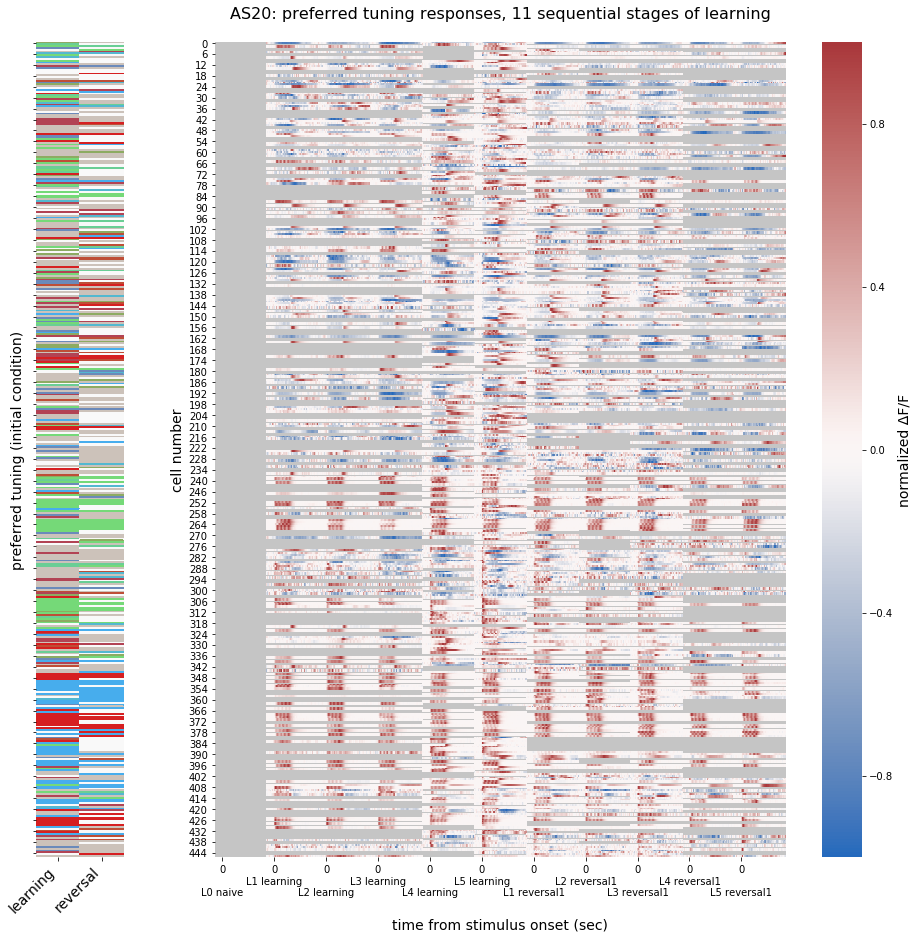

In [221]:
norm_row = True
# sorter = clus_sort  peak_sort

# allow for mapping between digits and colors (rather than tuning strings to colors)
possible_tuning = ['broad', 'minus', 'minus-neutral', 'minus-plus', 'neutral',
       'neutral-minus', 'neutral-plus', 'none', 'plus', 'plus-minus',
       'plus-neutral']
color_mapper = {} # map numbers to colors
list_mapper = {} # map colors to numbers
counter = 0
for k,v in cas.lookups.color_dict.items():
    if k not in possible_tuning:
        continue
    color_mapper[counter] = v
    list_mapper[k] = counter
    counter += 1

# map
tune_l1 = []
for s1 in stune:
    tune_l2 = []
    for s2 in s1:
        tune_l2.append(list_mapper[s2])
    tune_l1.append(tune_l2)
number_tune_mat = np.vstack(tune_l1)

ax = []
fig = plt.figure(figsize=(16, 15))
gs = fig.add_gridspec(100, 100)
ax.append(fig.add_subplot(gs[:, :10]))
ax.append(fig.add_subplot(gs[:, 20:]))

# plot "categorical" heatmap using defined color mappings
sns.heatmap(number_tune_mat.T[peak_sort, :], cmap=list(color_mapper.values()), ax=ax[0], cbar=False)
ax[0].set_xticklabels(['learning', 'reversal'], rotation=45, ha='right', size=14)
ax[0].set_yticklabels([])
ax[0].set_ylabel('preferred tuning (initial condition)', size=14)

# optionally noramilze across row using maximum absolute value
if norm_row:
    mat2d_norm = mat2d/np.nanmax(np.abs(mat2d), axis=1)[:, None]
    clabel = 'normalized \u0394F/F'
else:
    mat2d_norm = mat2d
    clabel = '\u0394F/F (z-score)'
    
g = sns.heatmap(mat2d_norm[peak_sort, :], ax=ax[1], center=0, cmap='vlag', cbar_kws={'label': clabel})
g.set_facecolor('#c5c5c5')
ax[1].set_title(f'{mouse}: preferred tuning responses, 11 sequential stages of learning\n', size=16)
stim_starts = [15.5 + 108*s for s in np.arange(len(cas.lookups.staging['parsed_11stage']))]
stim_labels = [f'0\n\n{s}' if c%2 == 0 else f'0\n{s}' for c, s in enumerate(cas.lookups.staging['parsed_11stage'])]
ax[1].set_xticks(stim_starts)
ax[1].set_xticklabels(stim_labels, rotation=0)
ax[1].set_ylabel('cell number', size=14)
ax[1].set_xlabel('\ntime from stimulus onset (sec)', size=14)

cbar = g.collections[0].colorbar
cbar.set_label(clabel, size=14)

plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_heatmap_LR_peak_{mouse}.png', bbox_inches='tight')
# plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_heatmap_LR_heir_{mouse}.pdf', bbox_inches='tight')


# TODO GET AVERAGE COSINE TUNING AND CLUSTER BY THIS

## get stage averages (cells averaged per stage of learning)

In [5]:
# loop over tensor, averaging different periods of time for all cells

# manually order learning stages
xorder = ['L0 naive',
          'L1 learning', 'L2 learning', 'L3 learning', 'L4 learning', 'L5 learning',
          'L1 reversal1', 'L2 reversal1', 'L3 reversal1', 'L4 reversal1', 'L5 reversal1']

mouse_stage_respones = {}
for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list):
    
    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]
    mouse_stage_respones[mouse] = {}
    
    # preallocate
    for s in xorder:
        blank = np.zeros((tensor.shape[0], tensor.shape[1], 4))
        blank[:] = np.nan
        mouse_stage_respones[mouse][s] = blank
    
    # get mean of pmn trials for each stage
    for s in xorder:
        for c, icue in enumerate(['plus', 'minus', 'neutral']):
            meta_bool = meta.parsed_11stage.isin([s]) & meta.condition.isin([icue])  # WHY IS THIS ICOND
            cue_stage_tensor = tensor[:, :, meta_bool]
            cue_stage_mean = np.nanmean(cue_stage_tensor, axis=2)
            mouse_stage_respones[mouse][s][:, :, c] = cue_stage_mean
            
    # add in a 4th z slice of preferred tuning responses
    tune_up = tune.reset_index()
    for s in xorder:
        for cell_n in range(tensor.shape[0]):
            pref = tune_up.loc[tune_up.cell_n.isin([cell_n + 1]) & tune_up.parsed_11stage.isin([s]), 'preferred tuning']
            if len(pref) == 1:
                preferred_tuning = pref.item()
                if preferred_tuning == 'broad':
                    # average across cues for broadly tuned cells
                    mean_resp = np.nanmean(mouse_stage_respones[mouse][s][cell_n, :, :], axis=1)
                    mouse_stage_respones[mouse][s][cell_n, :, 3] = mean_resp
                else:
                    # take single preferred tuning or average across joint tuned cells
                    tuning_levels = np.where([s in preferred_tuning for s in ['plus', 'minus', 'neutral']])[0]
                    tuned_response = np.nanmean(mouse_stage_respones[mouse][s][cell_n, :, tuning_levels], axis=0)
                    mouse_stage_respones[mouse][s][cell_n, :, 3] = tuned_response
    
#     stage_list = [] 
#     for s in xorder:
#         stage_list.append(mouse_stage_respones[mouse][s][:,:,3])
#     np.hstack(stage_list)

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:26: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:43: RuntimeWarning: Mean of empty slice


In [91]:
np.array([['test', 'test'], ['test', 'test']])

array([['test', 'test'],
       ['test', 'test']], dtype='<U4')

# correlate cells responses with themselves (across time) vs with other cells (same time)
- this is a partial argument against behavioral/motor confounds
- we may need to flag cells that come online or go offline across reversal (exclude online/offline cells)
    - this could also be done by removing cells whose trial factors are too low for that stage of learning
- could also just focus on learning for now

In [7]:
# who is an offset cell?
peaktimes = utils.get_peak_times(tensor)

'VF226'

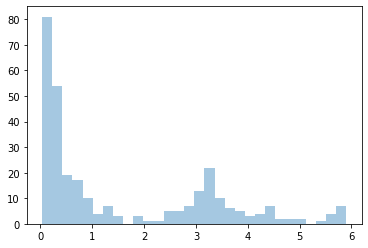

In [12]:
sns.distplot(peaktimes, kde=False, bins=30)
mouse

## self mean vs other mean correlations

In [ ]:
# two heatmaps (for every cell/stage)
#     1. mean correlation all pairwise for same cell compared to other stages
#     2. mean correlation all pairwise for cell compared to other cells same stage...

stages_to_correlate = ['L1 learning', 'L2 learning', 'L3 learning', 'L4 learning', 'L5 learning']

for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list):

    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]

    # who is an offset cell?
#     peaktimes = utils.get_peak_times(tensor)
    
    # heatmap 1 average pairwise corr across stages, same cell
    corr1_avgs = np.zeros((mouse_stage_respones[mouse][s].shape[0], len(stages_to_correlate)))
    corr1_avgs[:] = np.nan
    for cell_n in range(mouse_stage_respones[mouse][s].shape[0]):
        
        # build a timepoints x stage matrix for each cell
        corr = np.zeros((mouse_stage_respones[mouse][s].shape[1], len(stages_to_correlate)))
        for c, s in enumerate(stages_to_correlate):
            corr[:, c] = mouse_stage_respones[mouse][s][cell_n,:,3]
        
        # account for nan stages
        fill_inds = np.where(~np.isnan(corr[0, :]))[0]
        corrmat = np.corrcoef(corr[:, fill_inds].T)
        if corrmat.size <= 1:
            continue  # avoid only correlations with self
        np.fill_diagonal(corrmat, np.nan)  # inplace 
        mean_corr_vec_same_cell_other_stages = np.nanmean(corrmat, axis=0)
        
        # add to matrix for all cells 
        corr1_avgs[cell_n, fill_inds] = mean_corr_vec_same_cell_other_stages

        # need to decide how to do this correlation with regard to tuning.
        # point is that cells dynamics are the same between days of same cell rather than between cells 
        #    but should I then only focus on cells with the same tuning? 
            
    # heatmap 2 across cells, same stage
    corr2_avgs = np.zeros((mouse_stage_respones[mouse][s].shape[0], len(stages_to_correlate)))
    corr2_avgs[:] = np.nan
    for c, s in enumerate(stages_to_correlate):
        
        # build a timepoints x stage matrix for each cell
        corr = mouse_stage_respones[mouse][s][:,:,3]
        
        # account for nan stages
        cell_inds = np.where(~np.isnan(corr[:, 0]))[0]
        corrmat = np.corrcoef(corr[cell_inds, :])
        if corrmat.size <= 1:
            continue  # avoid only correlations with self
        np.fill_diagonal(corrmat, np.nan)  # inplace 
        mean_corr_vec_same_stage_other_cells = np.nanmean(corrmat, axis=0)
        
        # add to matrix for all cells 
        corr2_avgs[cell_inds, c] = mean_corr_vec_same_stage_other_cells
    
    
#     sorted_peaks = np.argsort(peaktimes)
    
    corr_sorted = np.argsort(np.nanmean(corr1_avgs, axis=1))
    
    fig, ax = plt.subplots(1,2, figsize=(15,12), sharey=True)
    g = sns.heatmap(corr1_avgs[corr_sorted, :], ax=ax[0], vmax=1, vmin=-0.5)
    g.set_facecolor('#c5c5c5')
    h = sns.heatmap(corr2_avgs[corr_sorted, :], ax=ax[1], vmax=1, vmin=-0.5)
    h.set_facecolor('#c5c5c5')

    ax[0].set_title(f'{mouse}: Response dynamics\nmean pairwise correlation\nw/ self across stages')
    ax[1].set_title(f'{mouse}: Response dynamics\nmean pairwise correlation\nw/ other cells for each stage')

    for axi in ax:
        stim_starts = np.arange(len(stages_to_correlate))
        stim_labels = stages_to_correlate
#         axi.set_xticks(stim_starts)
        axi.set_xticklabels(stim_labels, rotation=45)
        axi.set_ylabel('cell number', size=14)
        axi.set_xlabel('\nlearning stage', size=14)
#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_corr_heatmap_{mouse}.png', bbox_inches='tight')
#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_corr_heatmap_{mouse}.pdf', bbox_inches='tight')

## correlate with earliest learning bin

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:65: RuntimeWarning: Mean of empty slice


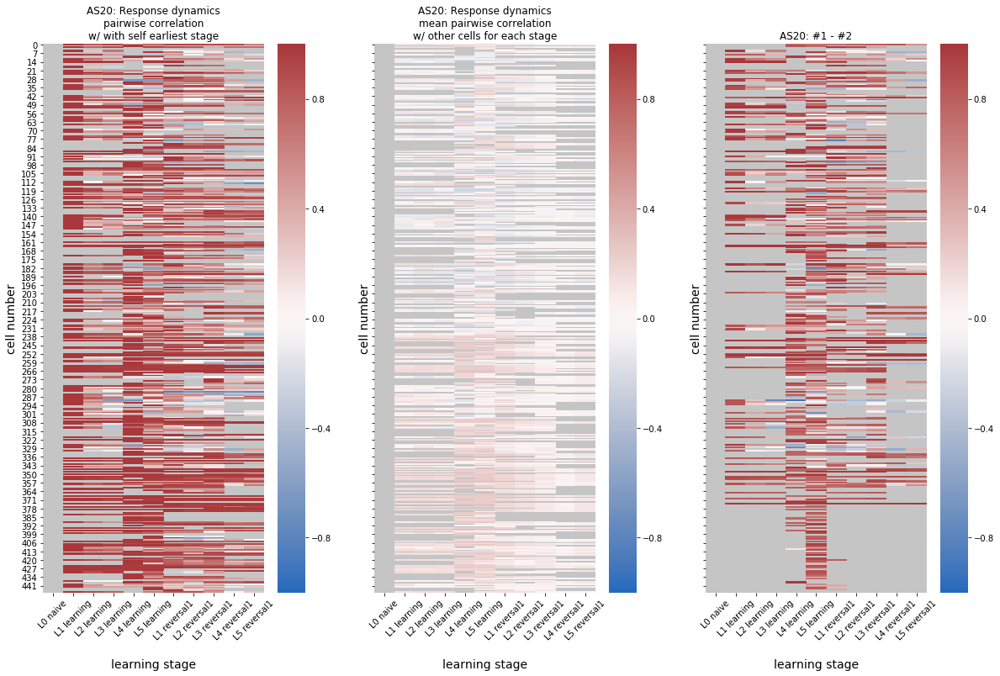

In [222]:
# two heatmaps (for every cell/stage)
#     1. mean correlation all pairwise for same cell compared to other stages
#     2. mean correlation all pairwise for cell compared to other cells same stage...

stages_to_correlate = cas.lookups.staging['parsed_11stage']

for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list):

    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]

    # who is an offset cell?
#     peaktimes = utils.get_peak_times(tensor)
    
    # heatmap 1 average pairwise corr across stages, same cell
    corr1_avgs = np.zeros((mouse_stage_respones[mouse][s].shape[0], len(stages_to_correlate)))
    corr1_avgs[:] = np.nan
    for cell_n in range(mouse_stage_respones[mouse][s].shape[0]):
        
        # build a timepoints x stage matrix for each cell
        corr = np.zeros((mouse_stage_respones[mouse][s].shape[1], len(stages_to_correlate)))
        for c, s in enumerate(stages_to_correlate):
            corr[:, c] = mouse_stage_respones[mouse][s][cell_n,:,3]
        
        # account for nan stages
        fill_inds = np.where(~np.isnan(corr[0, :]))[0]
        corrmat = np.corrcoef(corr[:, fill_inds].T)
        if corrmat.size <= 1:
            continue  # avoid only correlations with self
            
        pos_first_nonnan = corrmat[0, :]
#         np.fill_diagonal(corrmat, np.nan)  # inplace 
#         mean_corr_vec_same_cell_other_stages = np.nanmean(corrmat, axis=0)
        
        # add to matrix for all cells 
        corr1_avgs[cell_n, fill_inds] = pos_first_nonnan

        # need to decide how to do this correlation with regard to tuning.
        # point is that cells dynamics are the same between days of same cell rather than between cells 
        #    but should I then only focus on cells with the same tuning? 
#     break  
    
    # heatmap 2 across cells, same stage
    corr2_avgs = np.zeros((mouse_stage_respones[mouse][s].shape[0], len(stages_to_correlate)))
    corr2_avgs[:] = np.nan
    for c, s in enumerate(stages_to_correlate):
        
        # build a timepoints x stage matrix for each cell
        corr = mouse_stage_respones[mouse][s][:,:,3]
        
        # account for nan stages
        cell_inds = np.where(~np.isnan(corr[:, 0]))[0]
        corrmat = np.corrcoef(corr[cell_inds, :])
        if corrmat.size <= 1:
            continue  # avoid only correlations with self
        np.fill_diagonal(corrmat, np.nan)  # inplace 
        mean_corr_vec_same_stage_other_cells = np.nanmean(corrmat, axis=0)
        
        # add to matrix for all cells 
        corr2_avgs[cell_inds, c] = mean_corr_vec_same_stage_other_cells
    
    
#     sorted_peaks = np.argsort(peaktimes)
    
    corr_sorted = np.argsort(np.nanmean(corr1_avgs, axis=1))
    
    fig, ax = plt.subplots(1,3, figsize=(20,12), sharey=True)
    g = sns.heatmap(corr1_avgs[peak_sort, :], ax=ax[0], vmax=1, vmin=-1, cmap='vlag')
    g.set_facecolor('#c5c5c5')
    h = sns.heatmap(corr2_avgs[peak_sort, :], ax=ax[1], vmax=1, vmin=-1, cmap='vlag')
    h.set_facecolor('#c5c5c5')
    f = sns.heatmap(corr1_avgs[peak_sort, :] - corr2_avgs[corr_sorted, :], ax=ax[2], vmax=1, vmin=-1, cmap='vlag')
    f.set_facecolor('#c5c5c5')

    ax[0].set_title(f'{mouse}: Response dynamics\npairwise correlation\nw/ with self earliest stage')
    ax[1].set_title(f'{mouse}: Response dynamics\nmean pairwise correlation\nw/ other cells for each stage')
    ax[2].set_title(f'{mouse}: #1 - #2')

    for axi in ax:
        stim_starts = np.arange(len(stages_to_correlate))
        stim_labels = stages_to_correlate
#         axi.set_xticks(stim_starts)
        axi.set_xticklabels(stim_labels, rotation=45)
        axi.set_ylabel('cell number', size=14)
        axi.set_xlabel('\nlearning stage', size=14)
#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_corr_heatmap_{mouse}.png', bbox_inches='tight')
#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_corr_heatmap_{mouse}.pdf', bbox_inches='tight')
    break

## correlate with nanmean(L0/L1 or nothing)

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:76: RuntimeWarning: Mean of empty slice


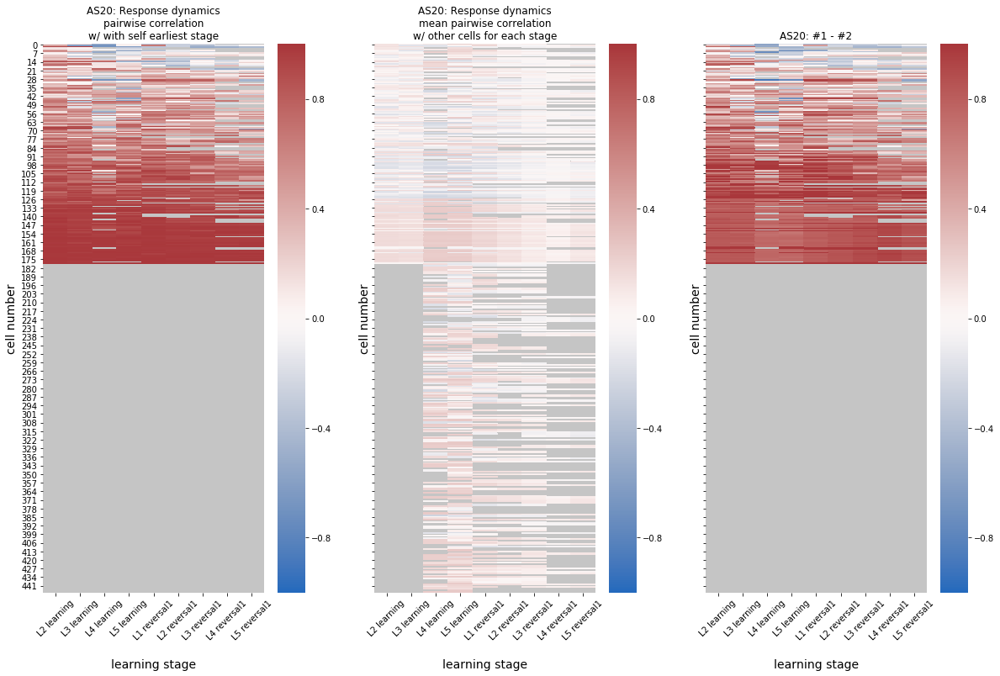

In [70]:
# two heatmaps (for every cell/stage)
#     1. mean correlation all pairwise for same cell compared to other stages
#     2. mean correlation all pairwise for cell compared to other cells same stage...

stages_to_correlate = cas.lookups.staging['parsed_11stage'][2:]

for meta, tensor, model, tune in zip(meta_list, tensor_list, model_list, tuning_list):

    # which mouse is it?
    mouse = meta.reset_index()['mouse'].unique()[0]

    # who is an offset cell?
#     peaktimes = utils.get_peak_times(tensor)
    
    # heatmap 1 average pairwise corr across stages, same cell
    corr1_avgs = np.zeros((mouse_stage_respones[mouse][s].shape[0], len(stages_to_correlate)))
    corr1_avgs[:] = np.nan
    cat_pref_early_learning = np.concatenate([mouse_stage_respones[mouse]['L0 naive'][:,:,3][:,:,None],
                                              mouse_stage_respones[mouse]['L1 learning'][:,:,3][:,:,None]], axis=2)
    mean_early_traces = np.nanmean(cat_pref_early_learning, axis=2)
    for cell_n in range(mouse_stage_respones[mouse][s].shape[0]):
        
        # only use cells that we have early
        # TODO could add other stages here
        if np.isnan(mean_early_traces[cell_n,0]):
            continue
    
        # build a timepoints x stage matrix for each cell
        corr = np.zeros((mouse_stage_respones[mouse][s].shape[1], len(stages_to_correlate) + 1))
        for c, s in enumerate(stages_to_correlate):
            corr[:, c] = mouse_stage_respones[mouse][s][cell_n,:,3]
        
        corr[:, -1] = mean_early_traces[cell_n,:]
        
        # account for nan stages
        fill_inds = np.where(~np.isnan(corr[0, :]))[0]
        corrmat = np.corrcoef(corr[:, fill_inds].T)
        if corrmat.size <= 1:
            continue  # avoid only correlations with self
        
        early_stage_corr_nonnan = corrmat[-1, :-1]
#         pos_first_nonnan = corrmat[0, :]
#         np.fill_diagonal(corrmat, np.nan)  # inplace 
#         mean_corr_vec_same_cell_other_stages = np.nanmean(corrmat, axis=0)
        
        # add to matrix for all cells 
        corr1_avgs[cell_n, fill_inds[:-1]] = early_stage_corr_nonnan  # fill skips the (last self value)

        # need to decide how to do this correlation with regard to tuning.
        # point is that cells dynamics are the same between days of same cell rather than between cells 
        #    but should I then only focus on cells with the same tuning? 
#     break  
    
    # heatmap 2 across cells, same stage
    corr2_avgs = np.zeros((mouse_stage_respones[mouse][s].shape[0], len(stages_to_correlate)))
    corr2_avgs[:] = np.nan
    for c, s in enumerate(stages_to_correlate):
        
        # build a timepoints x stage matrix for each cell
        corr = mouse_stage_respones[mouse][s][:,:,3]
        
        # account for nan stages
        cell_inds = np.where(~np.isnan(corr[:, 0]))[0]
        corrmat = np.corrcoef(corr[cell_inds, :])
        if corrmat.size <= 1:
            continue  # avoid only correlations with self
        np.fill_diagonal(corrmat, np.nan)  # inplace 
        mean_corr_vec_same_stage_other_cells = np.nanmean(corrmat, axis=0)
        
        # add to matrix for all cells 
        corr2_avgs[cell_inds, c] = mean_corr_vec_same_stage_other_cells
    
    
#     sorted_peaks = np.argsort(peaktimes)
    
    corr_sorted = np.argsort(np.nanmean(corr1_avgs, axis=1))
    
    fig, ax = plt.subplots(1,3, figsize=(20,12), sharey=True)
    g = sns.heatmap(corr1_avgs[corr_sorted, :], ax=ax[0], vmax=1, vmin=-1, cmap='vlag')
    g.set_facecolor('#c5c5c5')
    h = sns.heatmap(corr2_avgs[corr_sorted, :], ax=ax[1], vmax=1, vmin=-1, cmap='vlag')
    h.set_facecolor('#c5c5c5')
    f = sns.heatmap(corr1_avgs[corr_sorted, :] - corr2_avgs[corr_sorted, :], ax=ax[2], vmax=1, vmin=-1, cmap='vlag')
    f.set_facecolor('#c5c5c5')

    ax[0].set_title(f'{mouse}: Response dynamics\npairwise correlation\nw/ with self earliest stage')
    ax[1].set_title(f'{mouse}: Response dynamics\nmean pairwise correlation\nw/ other cells for each stage')
    ax[2].set_title(f'{mouse}: #1 - #2')

    for axi in ax:
        stim_starts = np.arange(len(stages_to_correlate))
        stim_labels = stages_to_correlate
#         axi.set_xticks(stim_starts)
        axi.set_xticklabels(stim_labels, rotation=45)
        axi.set_ylabel('cell number', size=14)
        axi.set_xlabel('\nlearning stage', size=14)
#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_corr_heatmap_{mouse}.png', bbox_inches='tight')
#     plt.savefig(f'/twophoton_analysis/Data/analysis/Group-attractive/pref_tuning_corr_heatmap_{mouse}.pdf', bbox_inches='tight')
    break

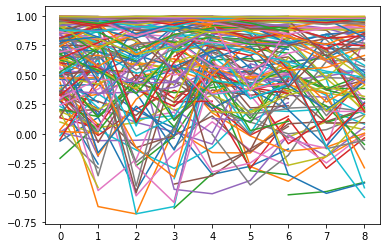

In [72]:
plt.plot(corr1_avgs[corr_sorted, :].T);

In [1]:
import os
path = 'S:\twophoton_analysis\Data\analysis\Group-counted\cvGLM_fractional_deviance_df.npy'
os.path.isdir(path)

# np.load(path)

False

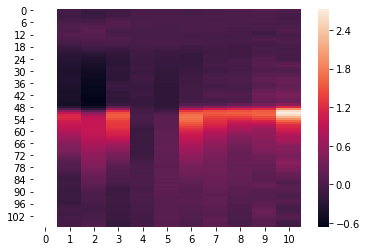

In [22]:
sns.heatmap(corr)

In [287]:
meta.columns

Index(['orientation', 'condition', 'initial_condition', 'trialerror',
       'prev_reward', 'prev_punish', 'prev_same_plus', 'prev_same_neutral',
       'prev_same_minus', 'prev_blank', 'hunger', 'learning_state', 'tag',
       'firstlick', 'firstlickbout', 'ensure', 'quinine', 'hmm_engaged',
       'speed', 'pre_speed', 'anticipatory_licks', 'pre_licks', 'pupil',
       'pre_pupil', 'brainmotion', 'go', 'reward', 'punishment',
       'p_initial_plus_since_last_initial_plus',
       'p_initial_minus_since_last_initial_plus',
       'p_initial_neutral_since_last_initial_plus',
       'p_go_since_last_initial_plus', 'p_reward_since_last_initial_plus',
       'p_initial_plus_since_last_initial_minus',
       'p_initial_minus_since_last_initial_minus',
       'p_initial_neutral_since_last_initial_minus',
       'p_go_since_last_initial_minus', 'p_reward_since_last_initial_minus',
       'p_initial_plus_since_last_initial_neutral',
       'p_initial_minus_since_last_initial_neutral',
      

In [297]:
meta.p_initial_plus_since_last_initial_plus.unique()

array([       nan, 0.16666667, 1.        , 0.5       , 0.33333333,
       0.14285714, 0.11111111, 0.25      , 0.1       , 0.2       ,
       0.08333333, 0.125     , 0.09090909, 0.07692308, 0.07142857,
       0.06666667, 0.05      , 0.04761905, 0.0625    , 0.05882353])

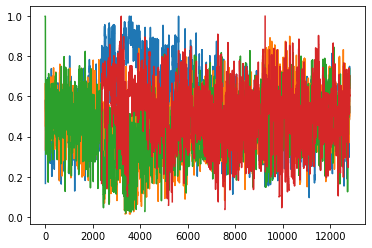

In [301]:
plt.plot(meta.p_initial_plus_since_last_initial_plus.rolling(window=20, min_periods=1).mean().values)
plt.plot(meta.p_initial_minus_since_last_initial_minus.rolling(window=20, min_periods=1).mean().values)
plt.plot(meta.p_initial_neutral_since_last_initial_neutral.rolling(window=20, min_periods=1).mean().values)
plt.plot(meta.p_go_since_last_reward.rolling(window=20, min_periods=1).mean().values)

In [302]:
peaktimes = utils.get_peak_times(tensor)

In [303]:
peaktimes.shape

(305,)

In [ ]:
##